# weather dataset

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import warnings
from datetime import datetime
start = datetime.now()
warnings.filterwarnings("ignore")

In [2]:
df_alger = pd.read_csv("Algiers.csv")
df_const = pd.read_csv("Constantine.csv")
df_oran = pd.read_csv("Oran.csv")
df_rabat = pd.read_csv("Rabat.csv")
df_tunis = pd.read_csv("Tunis.csv")

In [3]:
df = [df_alger,df_const,df_oran,df_rabat,df_tunis]

- data.info()
- data.describe()    
no need for applying normalization because the features are approximately in the same scale  
- data1.loc[(data1["TAVG"].isnull())&(data1["TMIN"].isnull())&(data1["TMAX"].isnull())]    
on peut remarque que sa n'existe pas la ou il y a la valeur de tmin et tmax et tavg nulle dans la meme individu
- data.isnull().sum()    
chaque dataset contient des valeurs null dans les quatre attributs PRCP TAVG TMAX TMIN 

# 1. overall preprocessing :

In [4]:
for i in range(len(df)):
    df[i]=df[i].drop_duplicates() 
    
    #### prétraitement des valeurs manquantes :
    
    #TAVG:
    # on va remplacer chaque valeur manquante de la températures moyen par la somme du TMAX + TMIN sur deux
    for j in range(df[i].shape[0]):
        if pd.isna(df[i]["TAVG"][j]) == True:
            df[i].loc[j, 'TAVG'] = (df[i]["TMAX"][j] + df[i]["TMIN"][j])/2
   # pour le reste des valeurs maquantes on vas les remplacer par la valeur du jour d'avant qui n'est pas 'Nan'
    df[i]["TAVG"] = df[i]["TAVG"].fillna(method='ffill') 
    
    #TMAX:
    # on va remplacer chaque valeur manquante de la températures maximal par 2 fois TAVG moins TMIN  
    for j in range(df[i].shape[0]):
        if pd.isna(df[i]["TMAX"][j]) == True:
            df[i].loc[j, 'TMAX'] = (2*df[i]["TAVG"][j] - df[i]["TMIN"][j])  
    # pour le reste des valeurs maquantes on vas les remplacer par la valeur du jour d'avant qui n'est pas 'Nan'
    df[i]["TMAX"] = df[i]["TMAX"].fillna(method='ffill')
    
    #TMIN:
    # on va remplacer chaque valeur nulles de la températures minimal par 2 fois TAVG moin TMAX
    for j in range(df[i].shape[0]):
        if pd.isna(df[i]["TMIN"][j]) == True:
            df[i].loc[j, 'TMIN'] = (2*df[i]["TAVG"][j] - df[i]["TMAX"][j]) 
    # pour le reste des valeurs maquantes on vas les remplacer par la valeur du jour d'avant qui n'est pas 'Nan'
    df[i]["TMIN"] = df[i]["TMIN"].fillna(method='ffill')

    #PRCP:
    #on va les remplacer les valeurs maquantes par la moyen de'PRCP' de chaque saison 
    # extraction des colonnes de l'année, le mois et jour a partir de la colonne DATE  
    df[i]['DATE']=pd.to_datetime(df[i]['DATE'])
    df[i]['Year']= df[i]['DATE'].dt.year 
    df[i]['Month']= df[i]['DATE'].dt.month
    df[i]['Day']= df[i]['DATE'].dt.day  
    # création de la colonne saison 
    season_dict = {1: '1', 2: '1',
                   3: '2', 4: '2', 5: '2',
                   6: '3', 7: '3', 8: '3',
                   9: '4', 10: '4', 11: '4',
                   12: '1'}
    df[i]['Season'] = df[i]['Month'].apply(lambda x: season_dict[x])
    #regroupement par saison
    grouped_season=df[i].groupby("Season")  
    winter=grouped_season.get_group('1')
    spring=grouped_season.get_group('2')
    summer=grouped_season.get_group('2')
    fall=grouped_season.get_group('4')
    #le calcule de la moyennede 'PRCP' de chaque saison
    moyen_prcp_winter=winter['PRCP'].mean()  
    moyen_prcp_spring=spring['PRCP'].mean()
    moyen_prcp_summer=summer['PRCP'].mean()
    moyen_prcp_fall=fall['PRCP'].mean()
    #remplacement :
    for j in range(len(df[i])):
        if (df[i]["PRCP"].isnull()[j] and df[i]["Season"][j]== '1'): 
            df[i].loc[j, 'PRCP'] = moyen_prcp_winter
        elif (df[i]["PRCP"].isnull()[j] and df[i]["Season"][j]== '2'): 
            df[i].loc[j, 'PRCP'] = moyen_prcp_spring
        elif (df[i]["PRCP"].isnull()[j] and df[i]["Season"][j]== '3'): 
            df[i].loc[j, 'PRCP'] = moyen_prcp_summer
        elif (df[i]["PRCP"].isnull()[j] and df[i]["Season"][j]=='4'): 
            df[i].loc[j, 'PRCP'] = moyen_prcp_fall


    #### Création de la colonne SNOW :
    # avec les conditions qui nous permettent de la crée 

    for j in range(len(df[i])):  
        df[i]['SNOW'] = np.select([(df[i]["PRCP"] > 0) & (df[i]["TAVG"] < 4)], [1], default=[0])
    
    ####groupe by date
    
    #donc a replacé les date qui se répetent par leur moyen sur 2 et au meme temps trier toutes les dates
    #on sélectionne aussi que les attributs essentiel
    groupe = df[i].groupby(df[i]["DATE"].dt.date)["DATE","PRCP","TAVG","TMAX","TMIN","SNOW"].mean()
    groupe['DATE'] = groupe.index #on recrée la colonne 'date' car aprés le "groupby" l'index sera 'date' 
    groupe=groupe.reset_index(drop=True) #on réinitialise l'index
    df[i] = groupe
    
    #retablir les valeurs de la colonne SNOW endommagé:
    for j in range(df[i].shape[0]):
        if (df[i]["SNOW"][j] == 0.5):
            df[i].loc[j,"SNOW"] = 1
    
    # Récréation des colonnes year, month, day, season
    df[i]['DATE']=pd.to_datetime(df[i]['DATE']) 
    df[i]['Year']= df[i]['DATE'].dt.year 
    df[i]['Month']= df[i]['DATE'].dt.month
    df[i]['Day']= df[i]['DATE'].dt.day 
    season_dict = {1: '1', 2: '1',
                   3: '2', 4: '2', 5: '2',
                   6: '3', 7: '3', 8: '3',
                   9: '4', 10: '4', 11: '4',
                   12: '1'}
    df[i]['Season'] = df[i]['Month'].apply(lambda x: season_dict[x])
    df[i]=df[i].round(2)


### le resultats du traitement des données :

#### Alger : 

In [5]:
print(df[0])

       PRCP  TAVG  TMAX  TMIN  SNOW       DATE  Year  Month  Day Season
0      0.00  11.0  20.7   4.2   0.0 1960-01-01  1960      1    1      1
1      0.00  11.0  18.5   4.8   0.0 1960-01-02  1960      1    2      1
2      0.00  12.4  18.6   6.5   0.0 1960-01-03  1960      1    3      1
3      0.00  10.7  17.8   4.8   0.0 1960-01-04  1960      1    4      1
4      0.00  11.8  17.6   8.0   0.0 1960-01-05  1960      1    5      1
...     ...   ...   ...   ...   ...        ...   ...    ...  ...    ...
22975  5.10  13.3  20.0   6.6   0.0 2022-12-01  2022     12    1      1
22976  0.00  13.9  20.0   7.8   0.0 2022-12-02  2022     12    2      1
22977  3.31  13.3  20.0   6.6   0.0 2022-12-03  2022     12    3      1
22978  0.00  14.1  20.0   8.2   0.0 2022-12-04  2022     12    4      1
22979  0.00  19.1  26.9  11.3   0.0 2022-12-05  2022     12    5      1

[22980 rows x 10 columns]


In [6]:
print(df[0].isnull().sum())

PRCP      0
TAVG      0
TMAX      0
TMIN      0
SNOW      0
DATE      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


#### Constantine :

In [7]:
print(df[1])

       PRCP  TAVG  TMAX  TMIN  SNOW       DATE  Year  Month  Day Season
0      0.00  11.0  20.7   4.2   0.0 1960-01-01  1960      1    1      1
1      0.00  11.0  18.5   4.8   0.0 1960-01-02  1960      1    2      1
2      0.00  12.4  18.6   6.5   0.0 1960-01-03  1960      1    3      1
3      0.00  10.7  17.8   4.8   0.0 1960-01-04  1960      1    4      1
4      0.00  11.8  17.6   8.0   0.0 1960-01-05  1960      1    5      1
...     ...   ...   ...   ...   ...        ...   ...    ...  ...    ...
22975  5.10  13.3  20.0   6.6   0.0 2022-12-01  2022     12    1      1
22976  0.00  13.9  20.0   7.8   0.0 2022-12-02  2022     12    2      1
22977  3.31  13.3  20.0   6.6   0.0 2022-12-03  2022     12    3      1
22978  0.00  14.1  20.0   8.2   0.0 2022-12-04  2022     12    4      1
22979  0.00  19.1  26.9  11.3   0.0 2022-12-05  2022     12    5      1

[22980 rows x 10 columns]


In [8]:
print(df[1].isnull().sum())

PRCP      0
TAVG      0
TMAX      0
TMIN      0
SNOW      0
DATE      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


#### Oran :

In [9]:
print(df[0])

       PRCP  TAVG  TMAX  TMIN  SNOW       DATE  Year  Month  Day Season
0      0.00  11.0  20.7   4.2   0.0 1960-01-01  1960      1    1      1
1      0.00  11.0  18.5   4.8   0.0 1960-01-02  1960      1    2      1
2      0.00  12.4  18.6   6.5   0.0 1960-01-03  1960      1    3      1
3      0.00  10.7  17.8   4.8   0.0 1960-01-04  1960      1    4      1
4      0.00  11.8  17.6   8.0   0.0 1960-01-05  1960      1    5      1
...     ...   ...   ...   ...   ...        ...   ...    ...  ...    ...
22975  5.10  13.3  20.0   6.6   0.0 2022-12-01  2022     12    1      1
22976  0.00  13.9  20.0   7.8   0.0 2022-12-02  2022     12    2      1
22977  3.31  13.3  20.0   6.6   0.0 2022-12-03  2022     12    3      1
22978  0.00  14.1  20.0   8.2   0.0 2022-12-04  2022     12    4      1
22979  0.00  19.1  26.9  11.3   0.0 2022-12-05  2022     12    5      1

[22980 rows x 10 columns]


In [10]:
print(df[0].isnull().sum())

PRCP      0
TAVG      0
TMAX      0
TMIN      0
SNOW      0
DATE      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


#### Rabat :

In [11]:
print(df[0])

       PRCP  TAVG  TMAX  TMIN  SNOW       DATE  Year  Month  Day Season
0      0.00  11.0  20.7   4.2   0.0 1960-01-01  1960      1    1      1
1      0.00  11.0  18.5   4.8   0.0 1960-01-02  1960      1    2      1
2      0.00  12.4  18.6   6.5   0.0 1960-01-03  1960      1    3      1
3      0.00  10.7  17.8   4.8   0.0 1960-01-04  1960      1    4      1
4      0.00  11.8  17.6   8.0   0.0 1960-01-05  1960      1    5      1
...     ...   ...   ...   ...   ...        ...   ...    ...  ...    ...
22975  5.10  13.3  20.0   6.6   0.0 2022-12-01  2022     12    1      1
22976  0.00  13.9  20.0   7.8   0.0 2022-12-02  2022     12    2      1
22977  3.31  13.3  20.0   6.6   0.0 2022-12-03  2022     12    3      1
22978  0.00  14.1  20.0   8.2   0.0 2022-12-04  2022     12    4      1
22979  0.00  19.1  26.9  11.3   0.0 2022-12-05  2022     12    5      1

[22980 rows x 10 columns]


In [12]:
print(df[0].isnull().sum())

PRCP      0
TAVG      0
TMAX      0
TMIN      0
SNOW      0
DATE      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


#### Tunis :

In [13]:
print(df[0])

       PRCP  TAVG  TMAX  TMIN  SNOW       DATE  Year  Month  Day Season
0      0.00  11.0  20.7   4.2   0.0 1960-01-01  1960      1    1      1
1      0.00  11.0  18.5   4.8   0.0 1960-01-02  1960      1    2      1
2      0.00  12.4  18.6   6.5   0.0 1960-01-03  1960      1    3      1
3      0.00  10.7  17.8   4.8   0.0 1960-01-04  1960      1    4      1
4      0.00  11.8  17.6   8.0   0.0 1960-01-05  1960      1    5      1
...     ...   ...   ...   ...   ...        ...   ...    ...  ...    ...
22975  5.10  13.3  20.0   6.6   0.0 2022-12-01  2022     12    1      1
22976  0.00  13.9  20.0   7.8   0.0 2022-12-02  2022     12    2      1
22977  3.31  13.3  20.0   6.6   0.0 2022-12-03  2022     12    3      1
22978  0.00  14.1  20.0   8.2   0.0 2022-12-04  2022     12    4      1
22979  0.00  19.1  26.9  11.3   0.0 2022-12-05  2022     12    5      1

[22980 rows x 10 columns]


In [14]:
print(df[0].isnull().sum())

PRCP      0
TAVG      0
TMAX      0
TMIN      0
SNOW      0
DATE      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


# 2. Visualisation des données :

## 2.1 par années :

### Température moyenne 'TAVG'

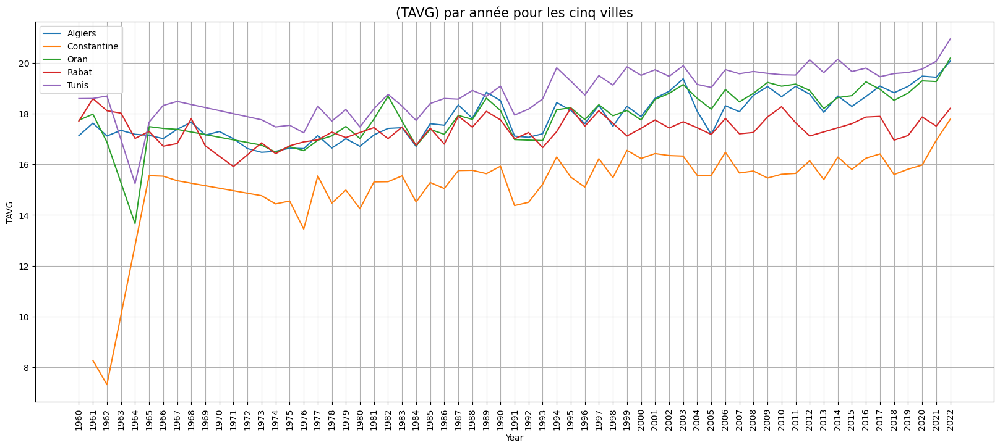

In [15]:
fig, ax = plt.subplots(figsize=(20,8))
df[0].groupby(df[0]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()
df[1].groupby(df[1]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()
df[2].groupby(df[2]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()
df[3].groupby(df[3]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()
df[4].groupby(df[4]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()

plt.xlabel("Year",fontsize=10)
plt.ylabel("TAVG",fontsize=10)
plt.title("(TAVG) par année pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"]) 
plt.xticks(np.arange(1960, 2023 , 1),rotation=90)
plt.grid()
plt.show()

###  Précipitation 'PRCP' :

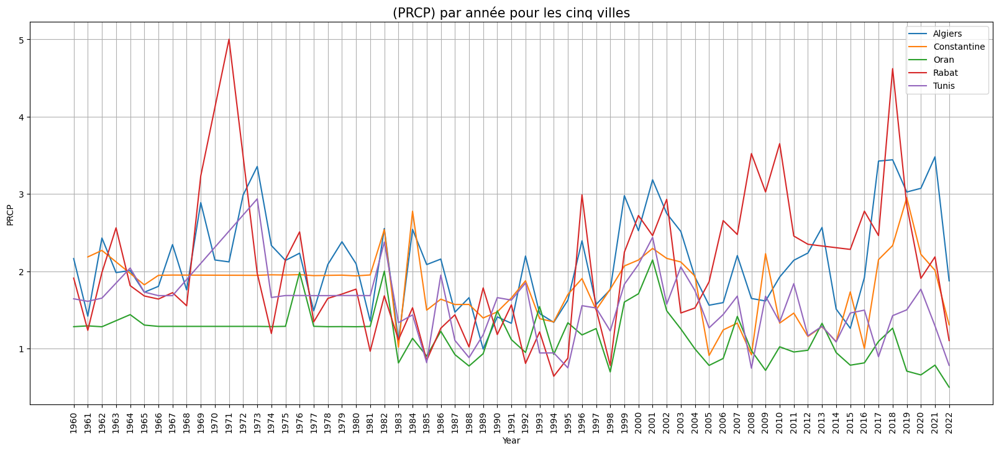

In [16]:
fig, ax = plt.subplots(figsize=(20,8))
df[0].groupby(df[0]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()
df[1].groupby(df[1]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()
df[2].groupby(df[2]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()
df[3].groupby(df[3]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()
df[4].groupby(df[4]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()

plt.xlabel("Year",fontsize=10)
plt.ylabel("PRCP",fontsize=10)
plt.title("(PRCP) par année pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"]) 
plt.xticks(np.arange(1960, 2023 , 1),rotation=90)
plt.grid()
plt.show()

###  Chute de neige 'SNOW' :

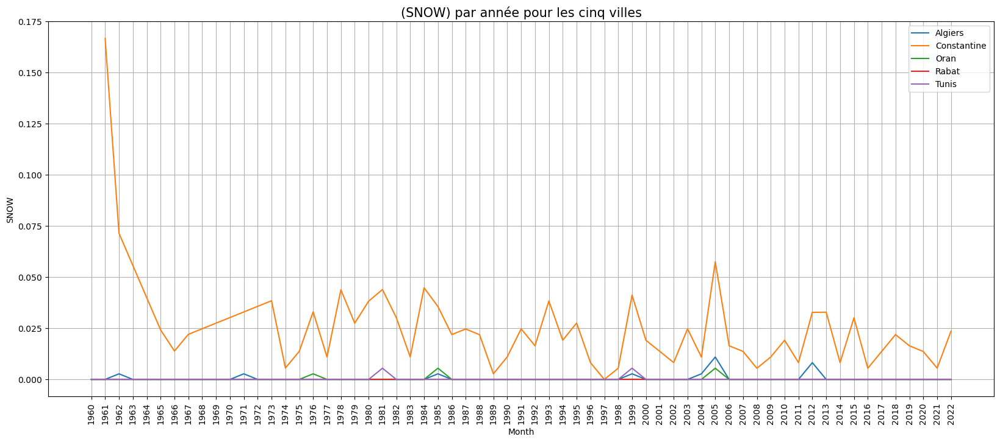

In [17]:
fig, ax = plt.subplots(figsize=(20,8))
df[0].groupby(df[0]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()
df[1].groupby(df[1]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()
df[2].groupby(df[2]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()
df[3].groupby(df[3]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()
df[4].groupby(df[4]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()

plt.xlabel("Month",fontsize=10)
plt.ylabel("SNOW",fontsize=10)
plt.title("(SNOW) par année pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"]) 
plt.xticks(np.arange(1960, 2023 , 1),rotation=90)
plt.grid()
plt.grid(True) 
plt.show()

## 2.2 Par saisons :

### Température moyenne 'TAVG'
    1- par la moyenne de toutes les années pour chaque saison :

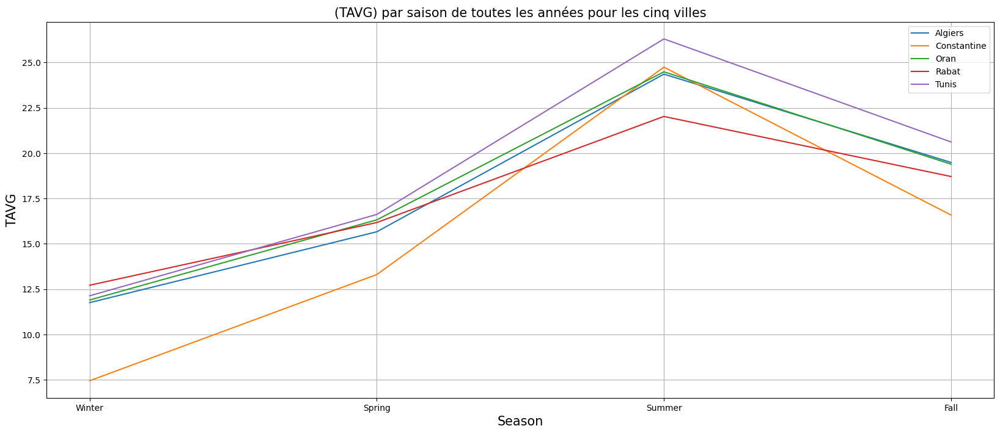

In [18]:
fig, ax = plt.subplots(figsize=(20,8))
df[0].groupby(df[0]["Season"]).apply(lambda x: x["TAVG"].mean()).plot()
df[1].groupby(df[1]["Season"]).apply(lambda x: x["TAVG"].mean()).plot()
df[2].groupby(df[2]["Season"]).apply(lambda x: x["TAVG"].mean()).plot()
df[3].groupby(df[3]["Season"]).apply(lambda x: x["TAVG"].mean()).plot()
df[4].groupby(df[4]["Season"]).apply(lambda x: x["TAVG"].mean()).plot()


plt.xlabel("Season",fontsize=15)
plt.ylabel("TAVG",fontsize=15)
plt.title("(TAVG) par saison de toutes les années pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"])
plt.xticks([0,1,2,3], ['Winter', 'Spring', 'Summer','Fall'])
plt.grid()
plt.show()

2- par la moyenne de chaque saison pour toutes les années  

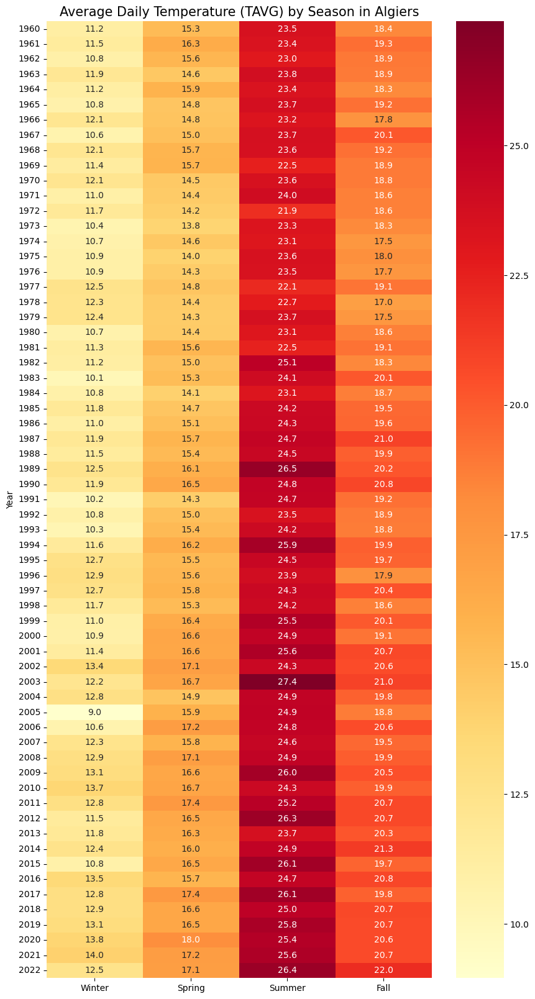

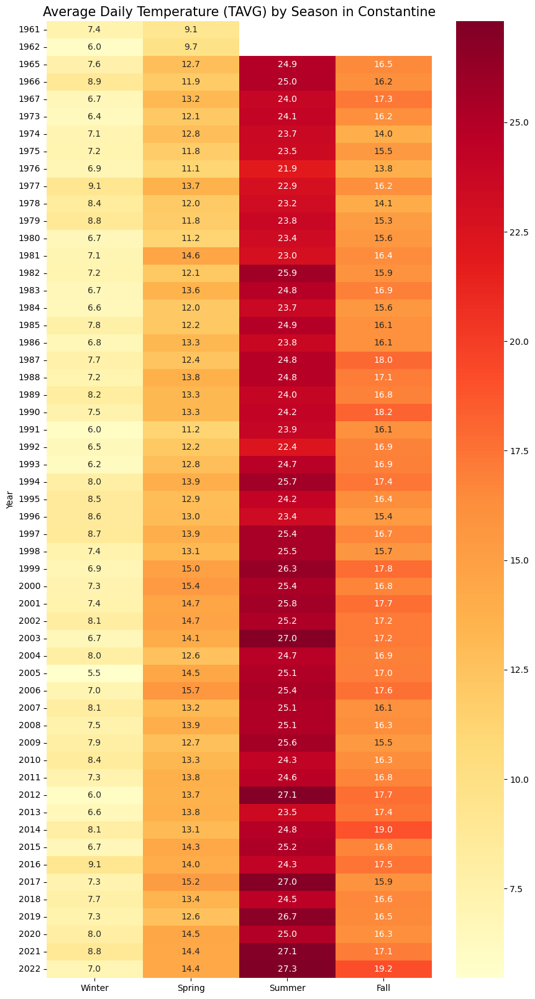

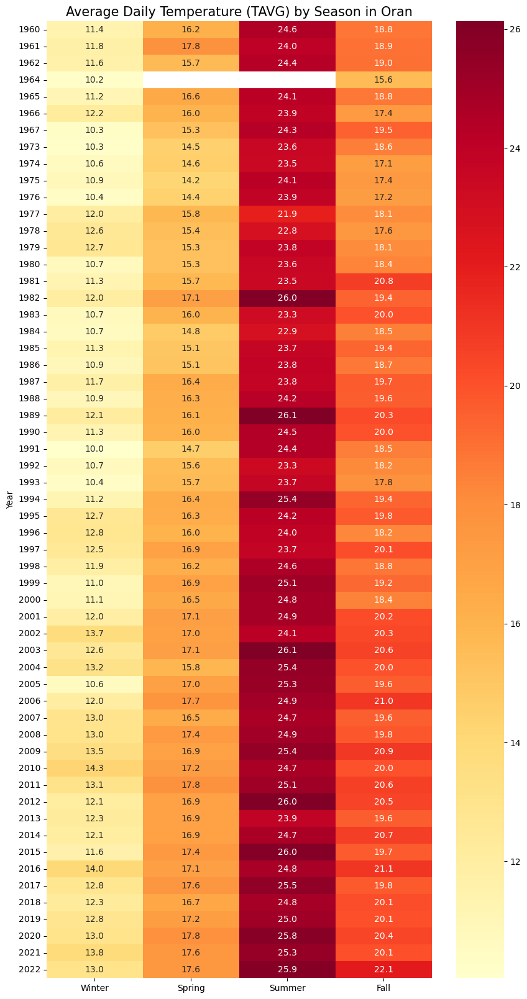

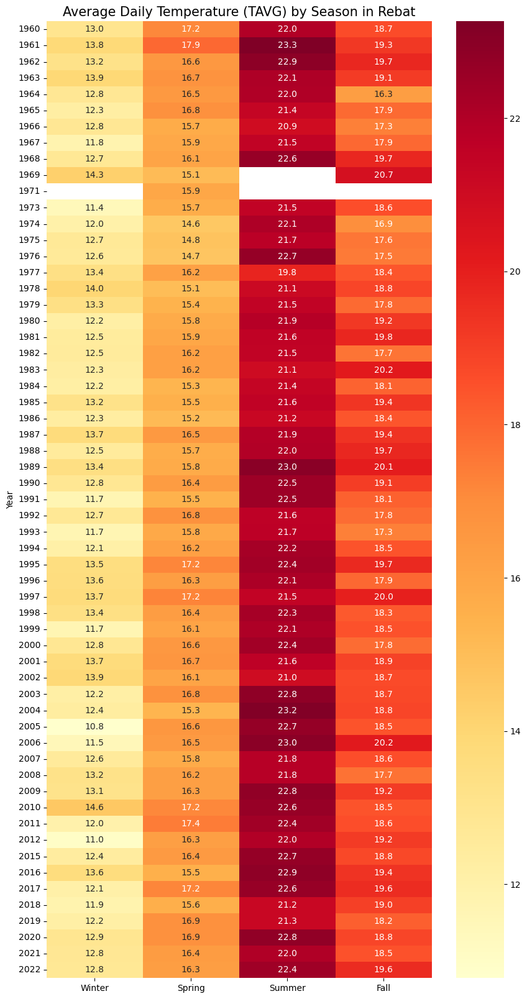

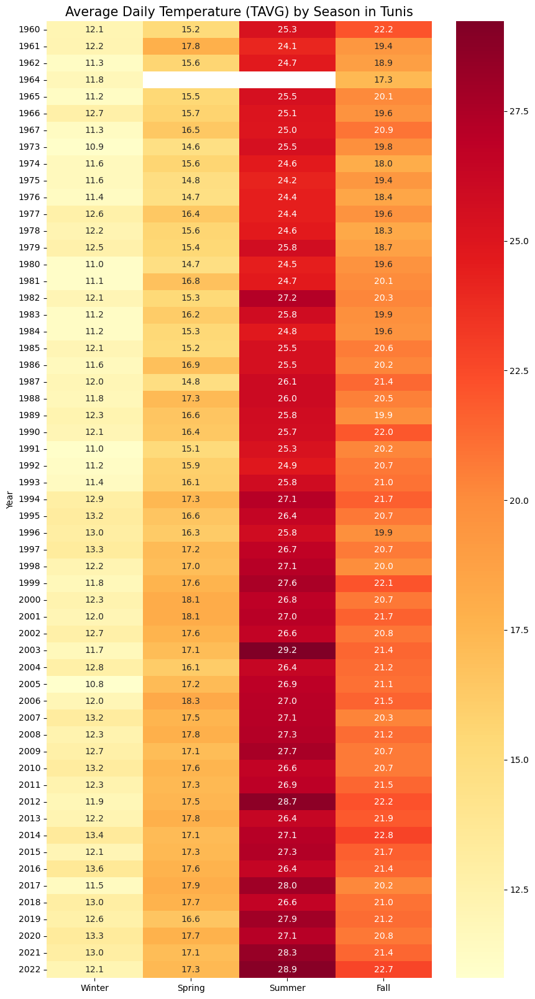

In [19]:
name=["Average Daily Temperature (TAVG) by Season in Algiers",
      "Average Daily Temperature (TAVG) by Season in Constantine",
      "Average Daily Temperature (TAVG) by Season in Oran",
      "Average Daily Temperature (TAVG) by Season in Rebat",
      "Average Daily Temperature (TAVG) by Season in Tunis"]
seasons = ['Winter','Spring','Summer','Fall'] 

for i in range(len(df)): 
    season_df= df[i].groupby(['Year','Season'], as_index=False)[['TAVG']].mean()
    data= season_df.pivot('Year','Season','TAVG')   
    data.columns = seasons
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='YlOrRd',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

###  Précipitation 'PRCP' :
1- par la moyenne de toutes les années pour chaque saison :

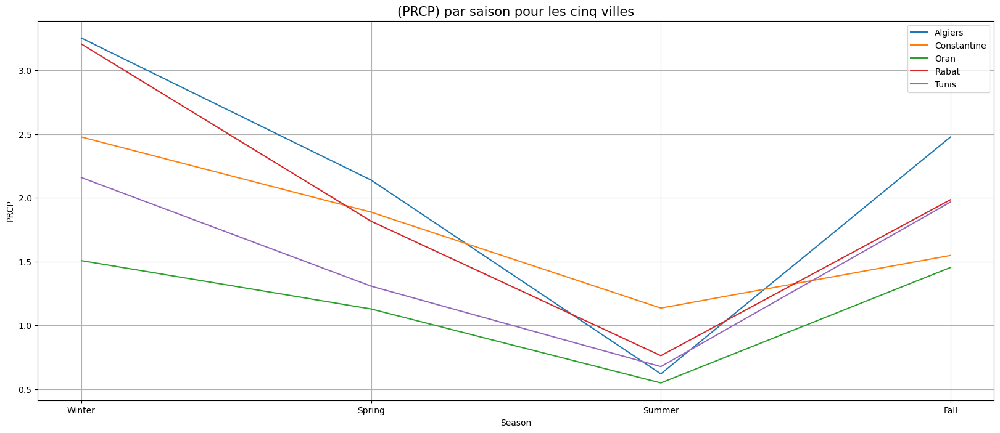

In [20]:
fig, ax = plt.subplots(figsize=(20,8))
df[0].groupby(df[0]["Season"]).apply(lambda x: x["PRCP"].mean()).plot()
df[1].groupby(df[1]["Season"]).apply(lambda x: x["PRCP"].mean()).plot()
df[2].groupby(df[2]["Season"]).apply(lambda x: x["PRCP"].mean()).plot()
df[3].groupby(df[3]["Season"]).apply(lambda x: x["PRCP"].mean()).plot()
df[4].groupby(df[4]["Season"]).apply(lambda x: x["PRCP"].mean()).plot()
 
plt.xlabel("Season",fontsize=10)
plt.ylabel("PRCP",fontsize=10)
plt.title("(PRCP) par saison pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"])
plt.xticks([0,1,2,3], ['Winter', 'Spring', 'Summer','Fall'])
plt.grid()
plt.show()

2- par la moyenne de chaque saison pour toutes les années  

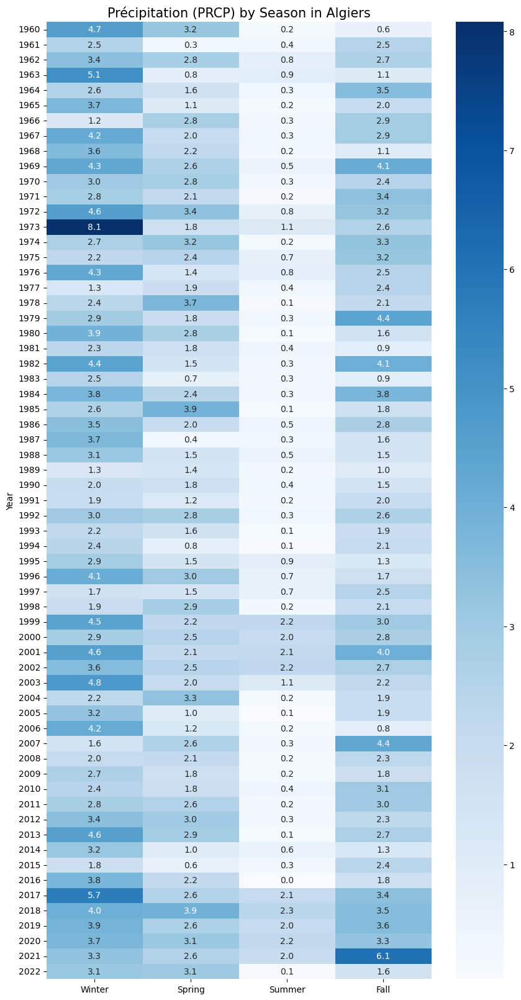

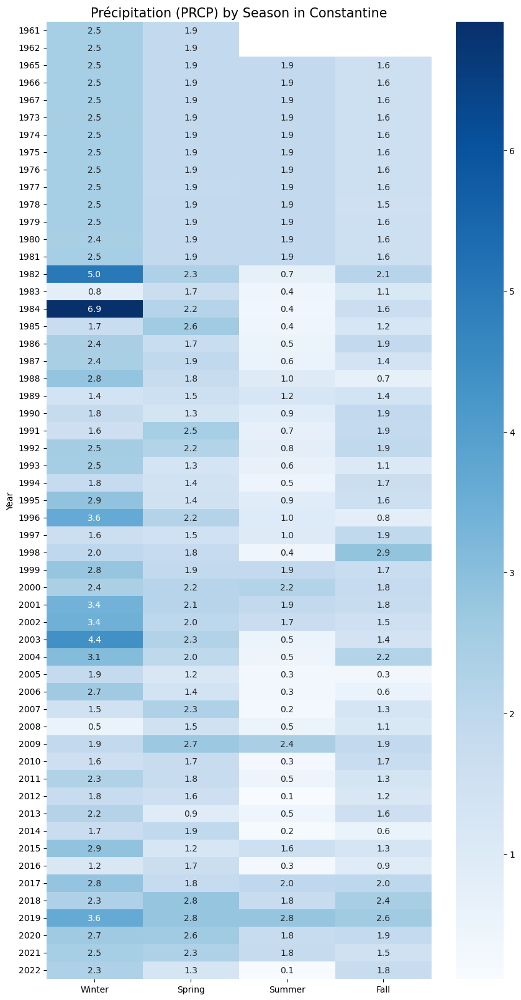

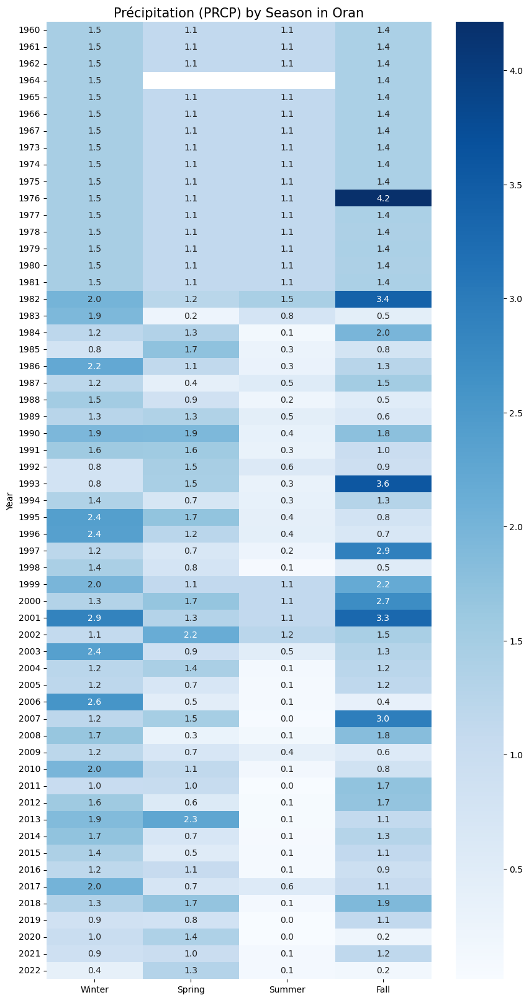

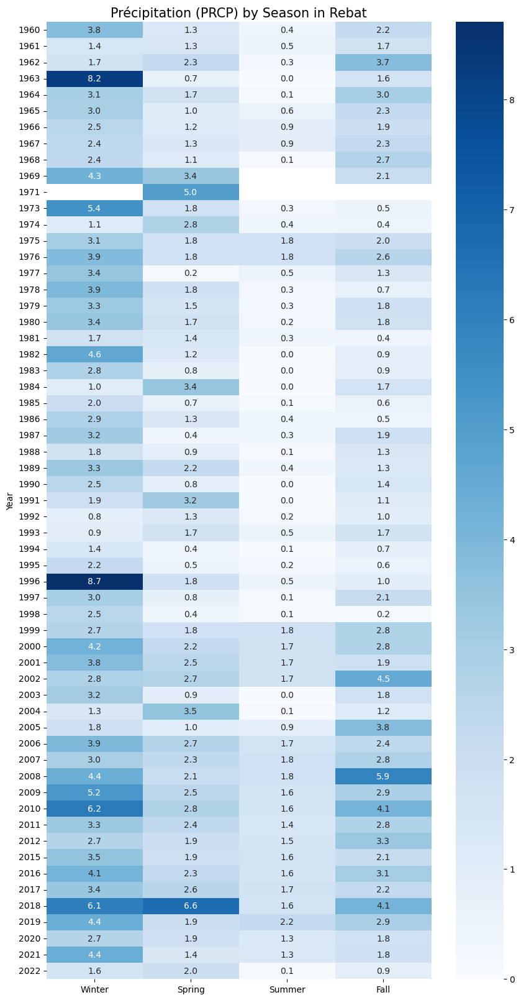

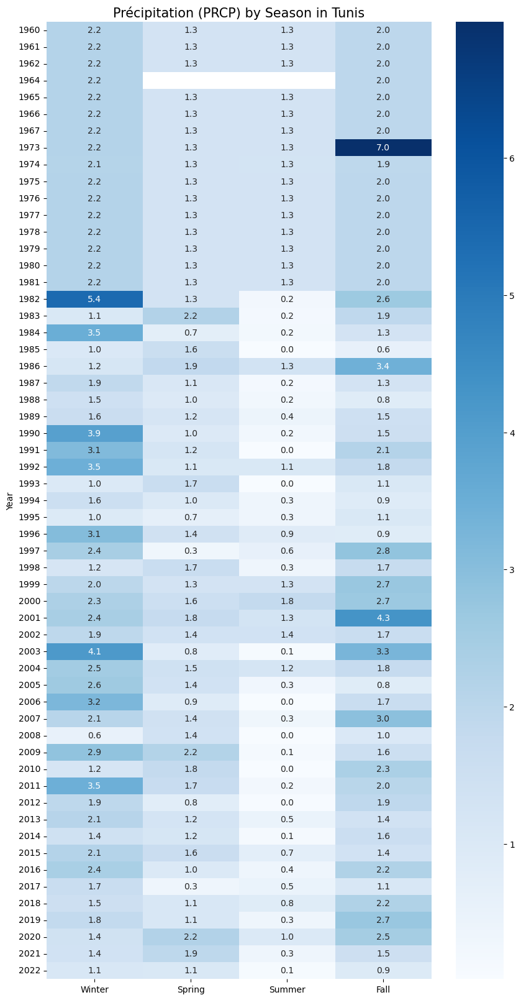

In [21]:
name=["Précipitation (PRCP) by Season in Algiers",
      "Précipitation (PRCP) by Season in Constantine",
      "Précipitation (PRCP) by Season in Oran",
      "Précipitation (PRCP) by Season in Rebat",
      "Précipitation (PRCP) by Season in Tunis"]
seasons = ['Winter','Spring','Summer','Fall'] 

for i in range(len(df)): 
    season_df= df[i].groupby(['Year','Season'], as_index=False)[['PRCP']].mean()
    data= season_df.pivot('Year','Season','PRCP')   
    data.columns = seasons
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='Blues',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

###  Chute de neige 'SNOW' :
1- par la moyenne de toutes les années pour chaque saison :

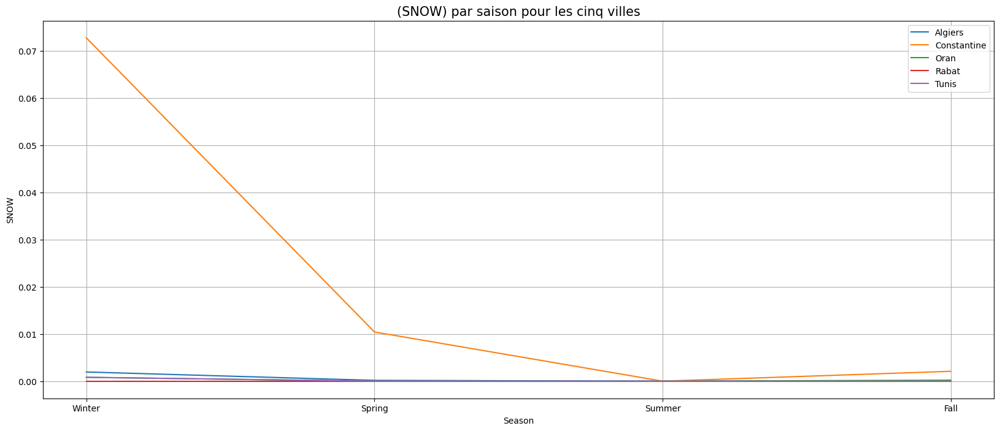

In [22]:
fig, ax = plt.subplots(figsize=(20,8))
df[0].groupby(df[0]["Season"]).apply(lambda x: x["SNOW"].mean()).plot()
df[1].groupby(df[1]["Season"]).apply(lambda x: x["SNOW"].mean()).plot()
df[2].groupby(df[2]["Season"]).apply(lambda x: x["SNOW"].mean()).plot()
df[3].groupby(df[3]["Season"]).apply(lambda x: x["SNOW"].mean()).plot()
df[4].groupby(df[4]["Season"]).apply(lambda x: x["SNOW"].mean()).plot()

plt.xlabel("Season",fontsize=10)
plt.ylabel("SNOW",fontsize=10)
plt.title("(SNOW) par saison pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"])
plt.xticks([0,1,2,3], ['Winter', 'Spring', 'Summer','Fall'])
plt.grid()
plt.show()

2- par la moyenne de chaque saison pour toutes les années

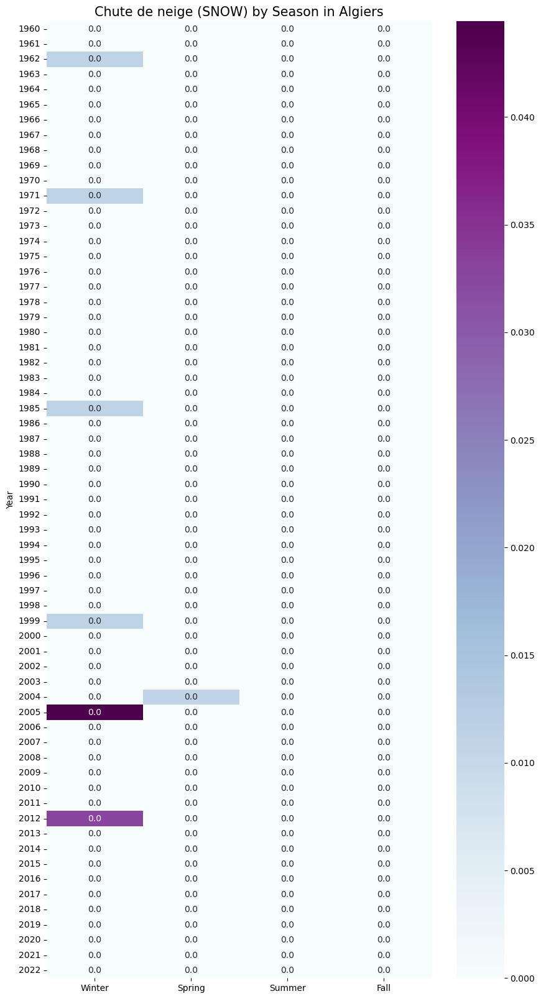

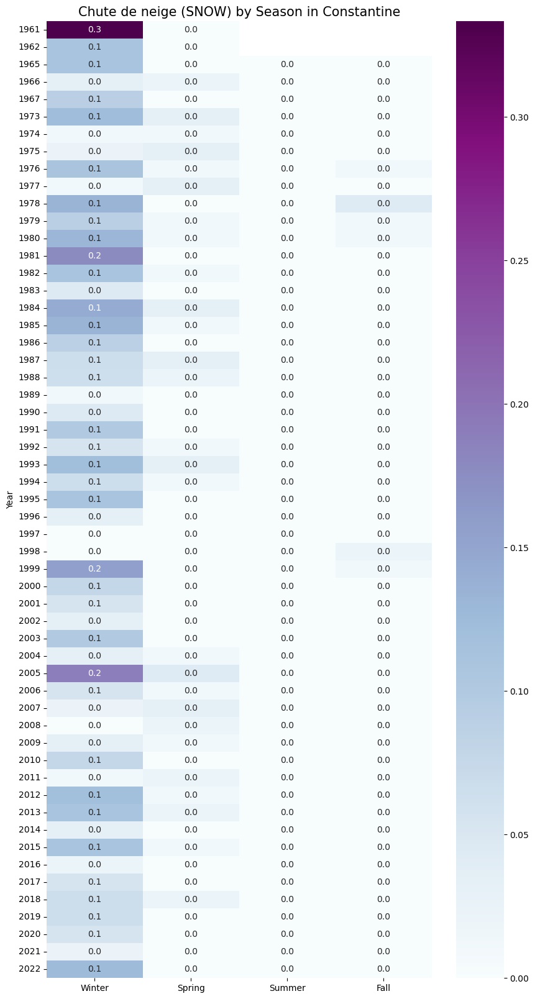

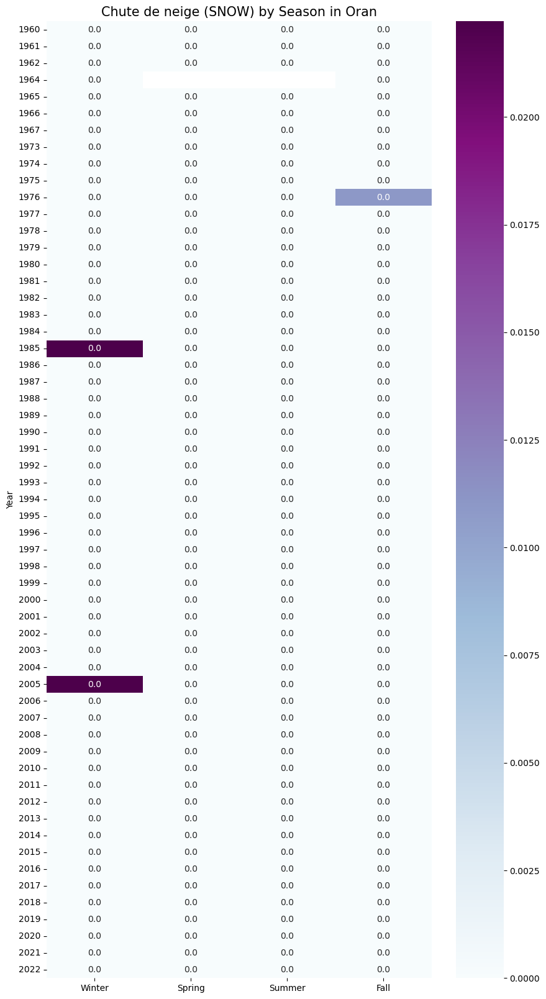

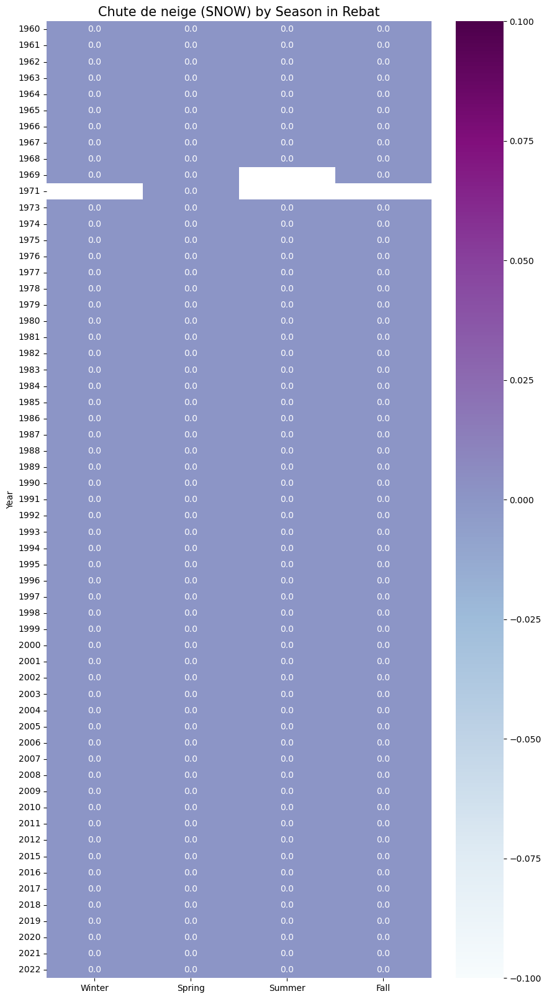

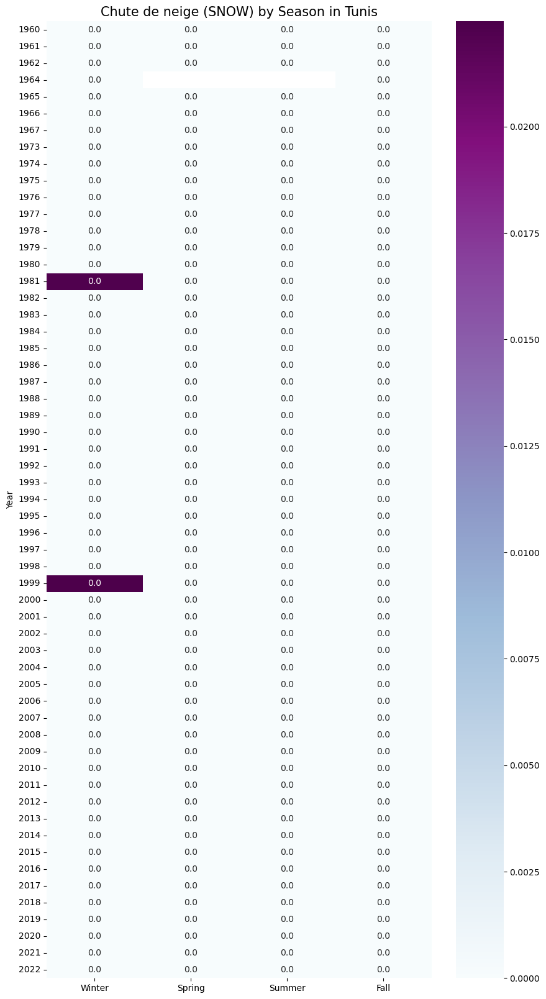

In [23]:
name=["Chute de neige (SNOW) by Season in Algiers",
      "Chute de neige (SNOW) by Season in Constantine",
      "Chute de neige (SNOW) by Season in Oran",
      "Chute de neige (SNOW) by Season in Rebat",
      "Chute de neige (SNOW) by Season in Tunis"]
seasons = ['Winter','Spring','Summer','Fall'] 

for i in range(len(df)): 
    season_df= df[i].groupby(['Year','Season'], as_index=False)[['SNOW']].mean()
    data= season_df.pivot('Year','Season','SNOW')   
    data.columns = seasons
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='BuPu',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

## 2.3 Par mois : 

### Température moyenne 'TAVG' :
1- par la moyenne de toutes les années pour chaque mois :

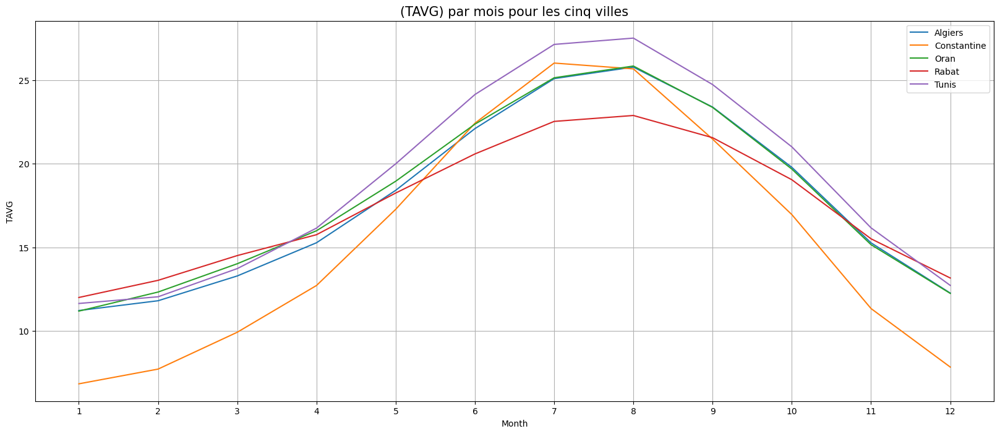

In [24]:
fig, ax = plt.subplots(figsize=(20,8))
df[0].groupby(df[0]["Month"]).apply(lambda x: x["TAVG"].mean()).plot()
df[1].groupby(df[1]["Month"]).apply(lambda x: x["TAVG"].mean()).plot()
df[2].groupby(df[2]["Month"]).apply(lambda x: x["TAVG"].mean()).plot()
df[3].groupby(df[3]["Month"]).apply(lambda x: x["TAVG"].mean()).plot()
df[4].groupby(df[4]["Month"]).apply(lambda x: x["TAVG"].mean()).plot()

plt.xlabel("Month",fontsize=10)
plt.ylabel("TAVG",fontsize=10)
plt.title("(TAVG) par mois pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"])
plt.xticks(np.arange(1, 13 , 1))
plt.grid()
plt.show()

2- par la moyenne de chaque mois pour toutes les années

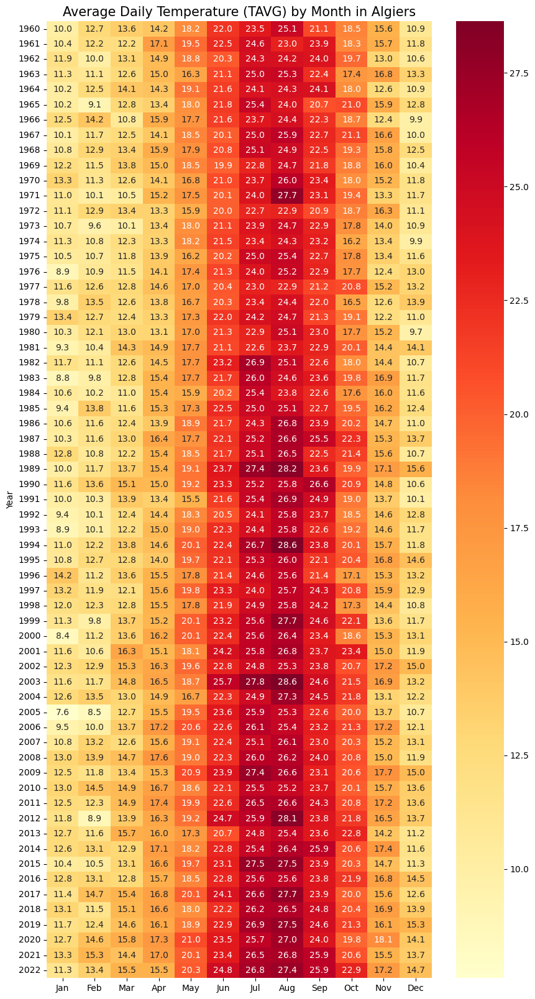

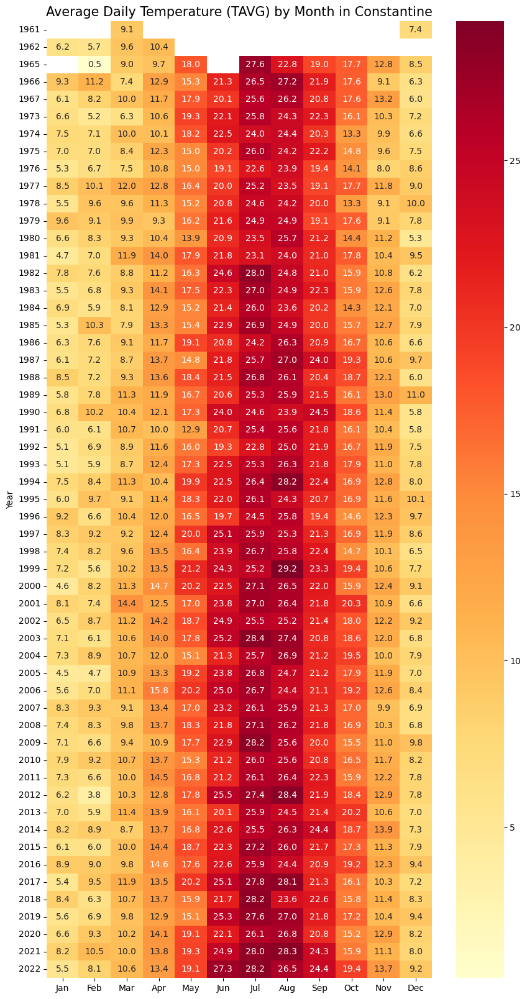

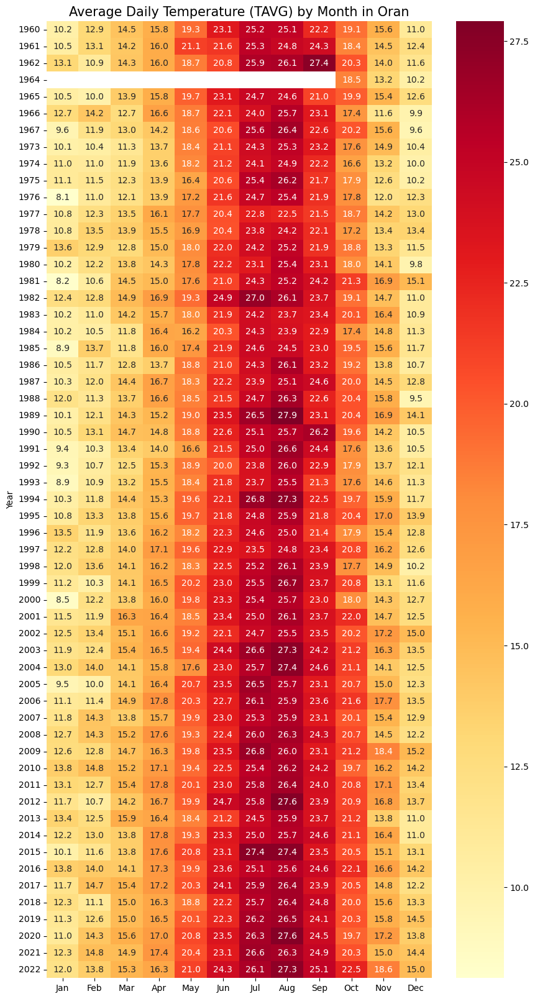

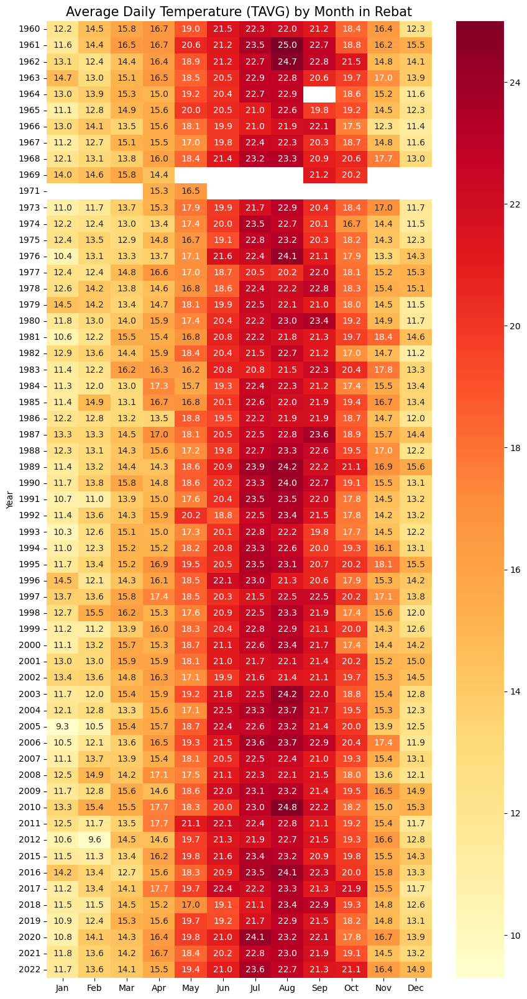

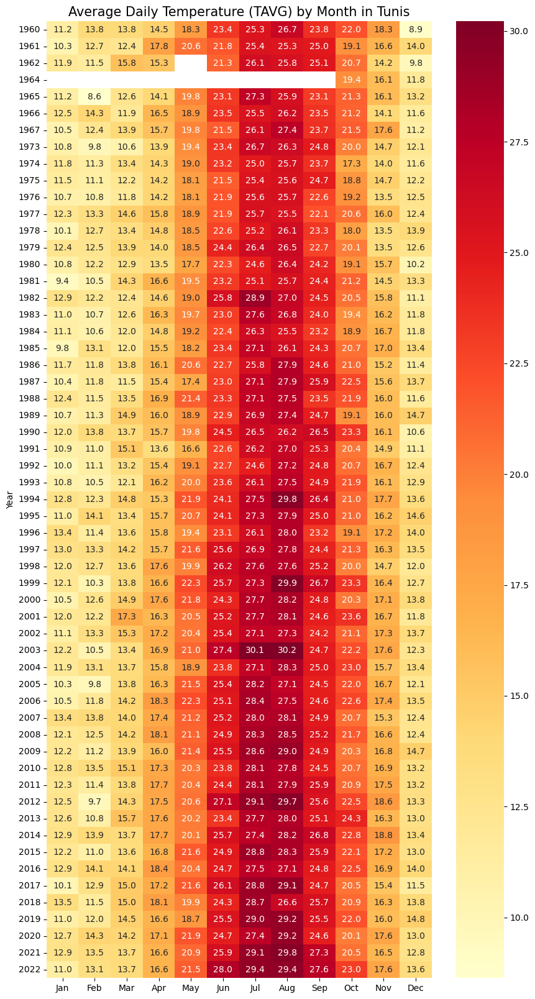

In [25]:
name=["Average Daily Temperature (TAVG) by Month in Algiers",
      "Average Daily Temperature (TAVG) by Month in Constantine",
      "Average Daily Temperature (TAVG) by Month in Oran",
      "Average Daily Temperature (TAVG) by Month in Rebat",
      "Average Daily Temperature (TAVG) by Month in Tunis"]
months = ['Jan','Feb','Mar','Apr','May','Jun',
          'Jul','Aug','Sep','Oct','Nov','Dec']

for i in range(len(df)): 
    month_df= df[i].groupby(['Year','Month'], as_index=False)[['TAVG']].mean()
    data= month_df.pivot('Year','Month','TAVG')   
    data.columns = months
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='YlOrRd',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

###  Précipitation 'PRCP' :
1- par la moyenne de toutes les années pour chaque mois :

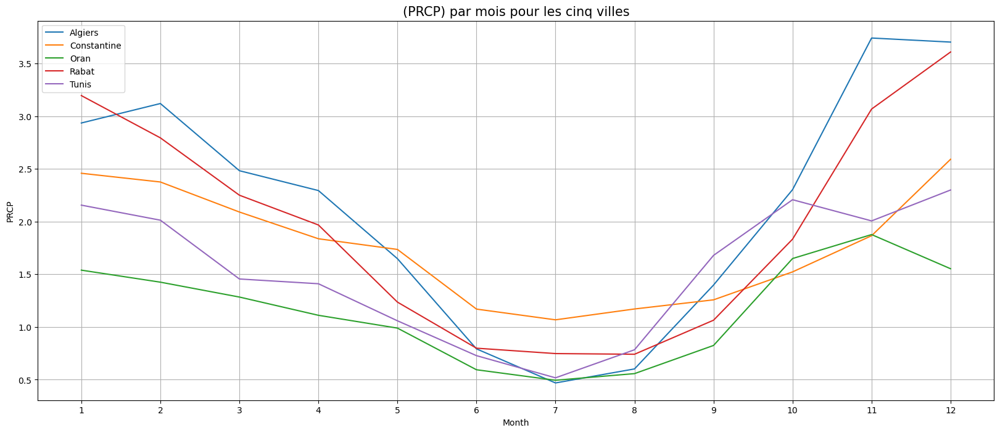

In [26]:
fig, ax = plt.subplots(figsize=(20,8))
df[0].groupby(df[0]["Month"]).apply(lambda x: x["PRCP"].mean()).plot()
df[1].groupby(df[1]["Month"]).apply(lambda x: x["PRCP"].mean()).plot()
df[2].groupby(df[2]["Month"]).apply(lambda x: x["PRCP"].mean()).plot()
df[3].groupby(df[3]["Month"]).apply(lambda x: x["PRCP"].mean()).plot()
df[4].groupby(df[4]["Month"]).apply(lambda x: x["PRCP"].mean()).plot()

plt.xlabel("Month",fontsize=10)
plt.ylabel("PRCP",fontsize=10)
plt.title("(PRCP) par mois pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"])
plt.xticks(np.arange(1, 13 , 1))
plt.grid()
plt.show()

2- par la moyenne de chaque mois pour toutes les années

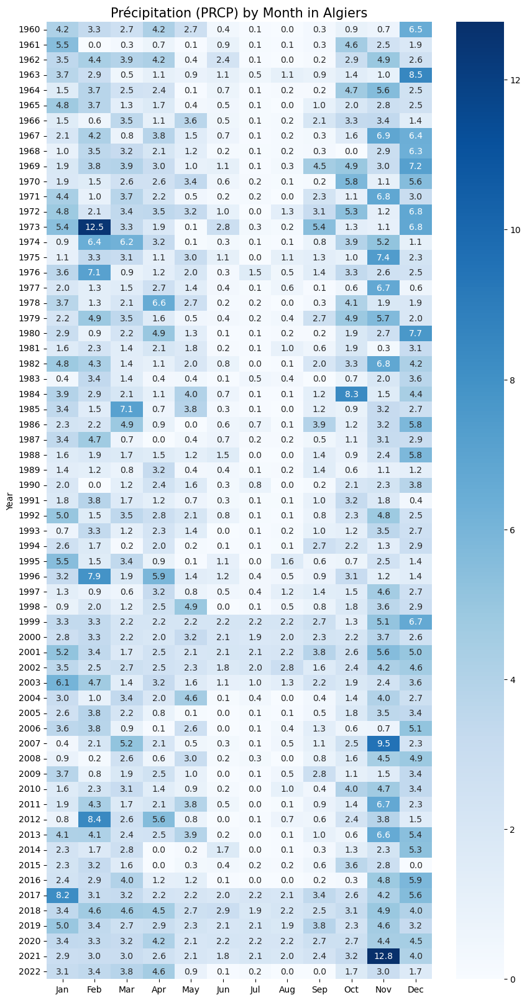

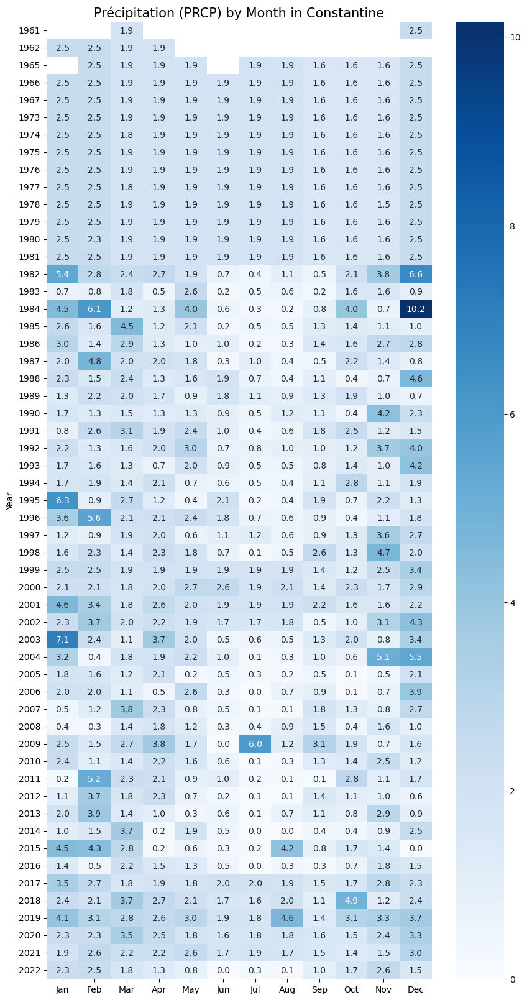

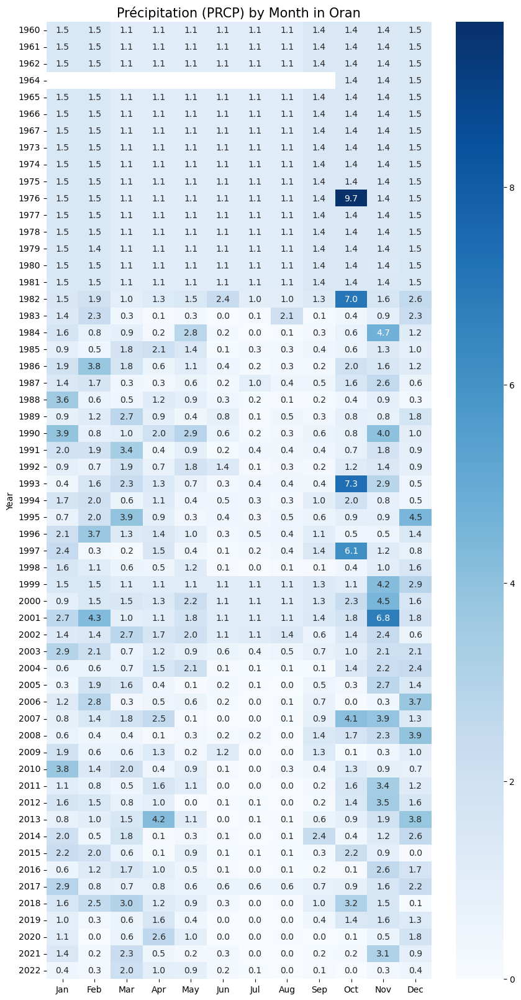

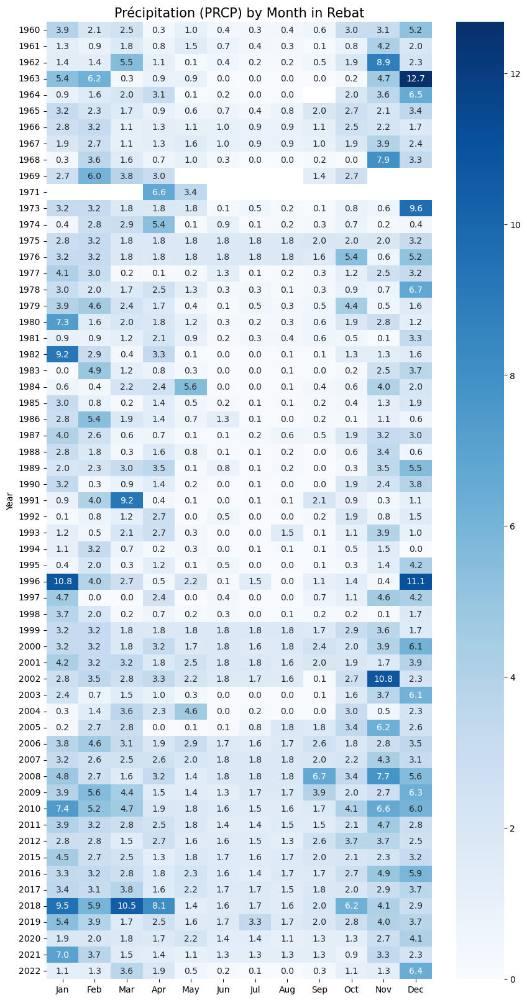

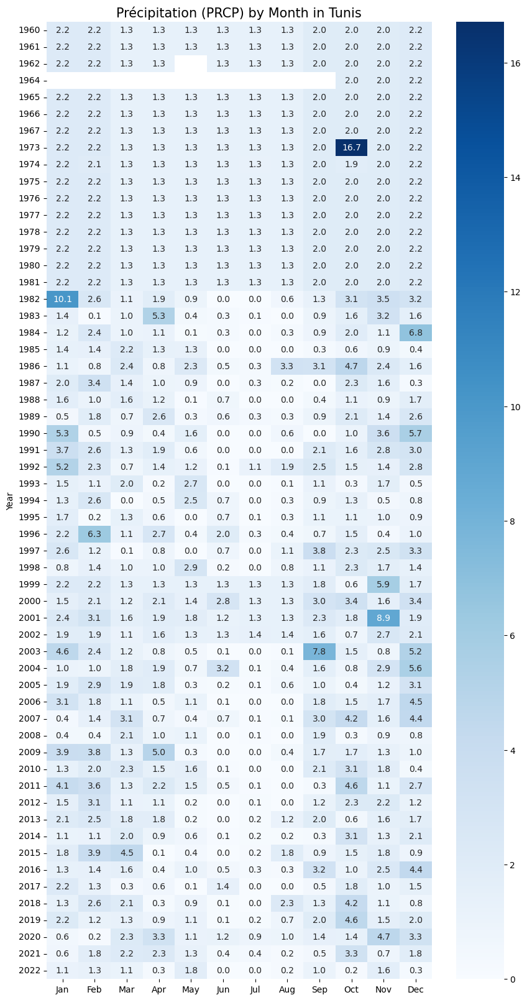

In [27]:
name=["Précipitation (PRCP) by Month in Algiers",
      "Précipitation (PRCP) by Month in Constantine",
      "Précipitation (PRCP) by Month in Oran",
      "Précipitation (PRCP) by Month in Rebat",
      "Précipitation (PRCP) by Month in Tunis"]
months = ['Jan','Feb','Mar','Apr','May','Jun',
          'Jul','Aug','Sep','Oct','Nov','Dec']

for i in range(len(df)): 
    month_df= df[i].groupby(['Year','Month'], as_index=False)[['PRCP']].mean()
    data= month_df.pivot('Year','Month','PRCP')   
    data.columns = months
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='Blues',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

###  Chute de neige 'SNOW' :
1- par la moyenne de toutes les années pour chaque mois :

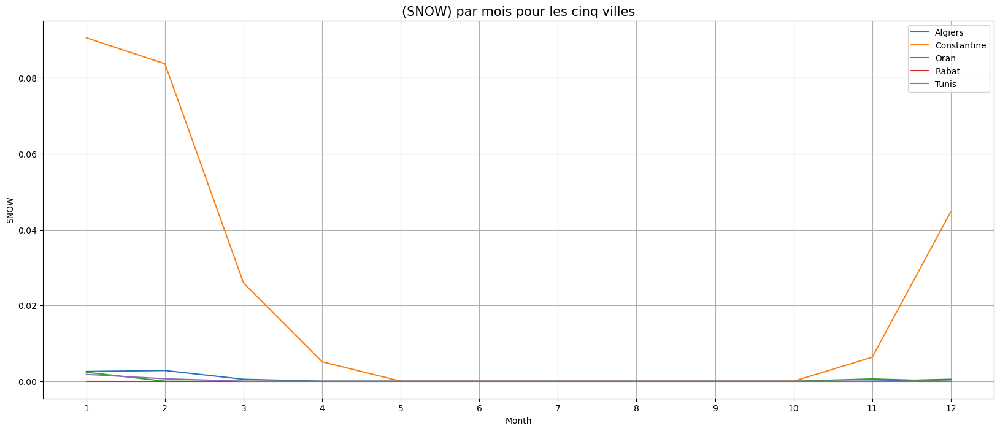

In [28]:
fig, ax = plt.subplots(figsize=(20,8))
df[0].groupby(df[0]["Month"]).apply(lambda x: x["SNOW"].mean()).plot()
df[1].groupby(df[1]["Month"]).apply(lambda x: x["SNOW"].mean()).plot()
df[2].groupby(df[2]["Month"]).apply(lambda x: x["SNOW"].mean()).plot()
df[3].groupby(df[3]["Month"]).apply(lambda x: x["SNOW"].mean()).plot()
df[4].groupby(df[4]["Month"]).apply(lambda x: x["SNOW"].mean()).plot()

plt.xlabel("Month",fontsize=10)
plt.ylabel("SNOW",fontsize=10)
plt.title("(SNOW) par mois pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"])
plt.xticks(np.arange(1, 13 , 1))
plt.grid()
plt.show()

2- par la moyenne de chaque mois pour toutes les années

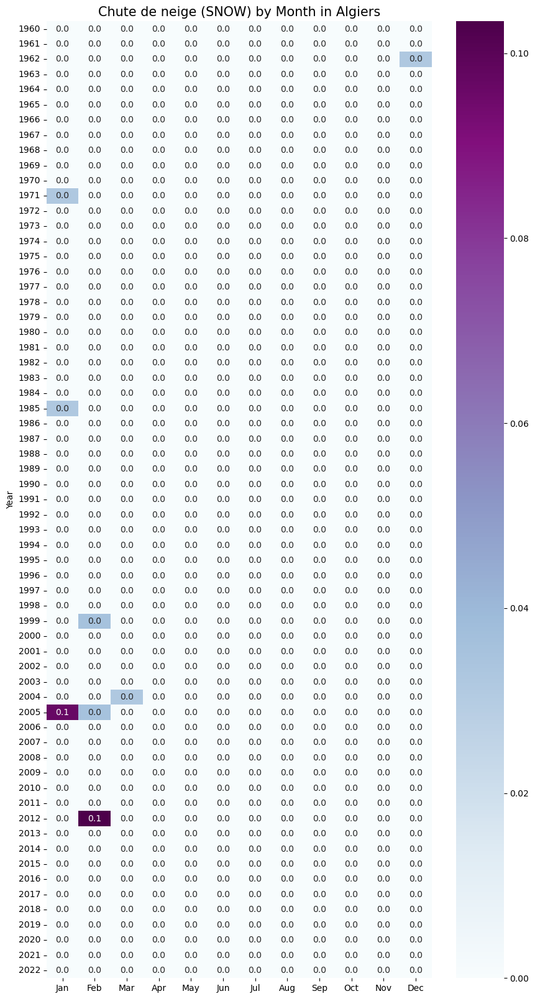

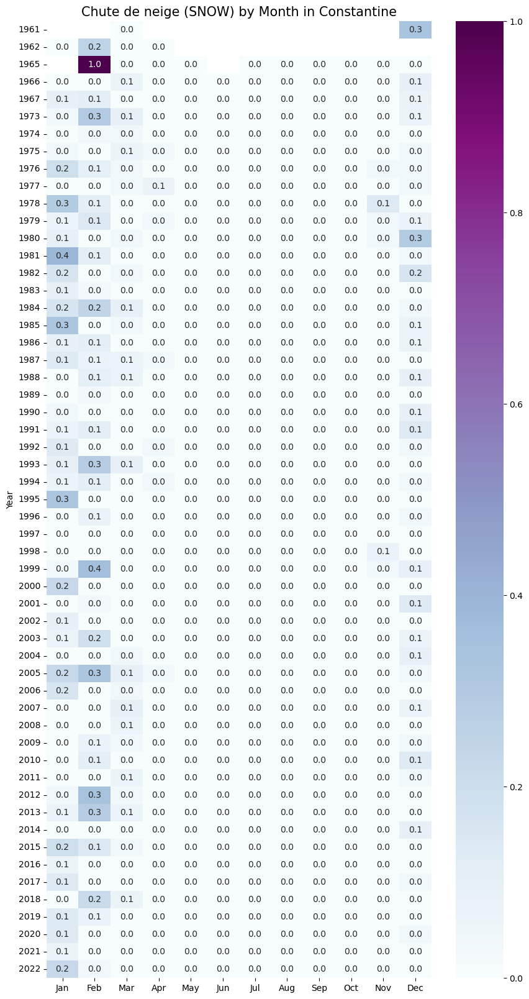

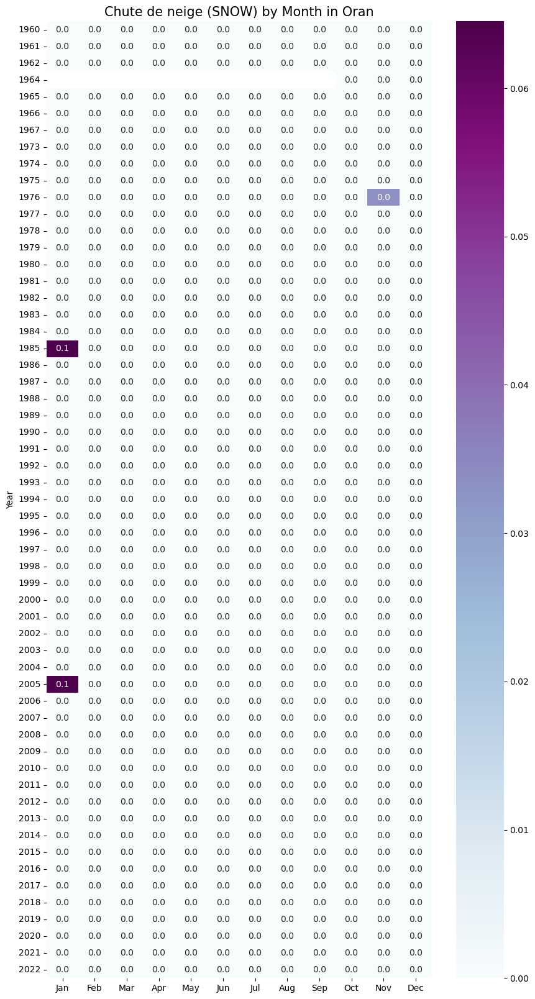

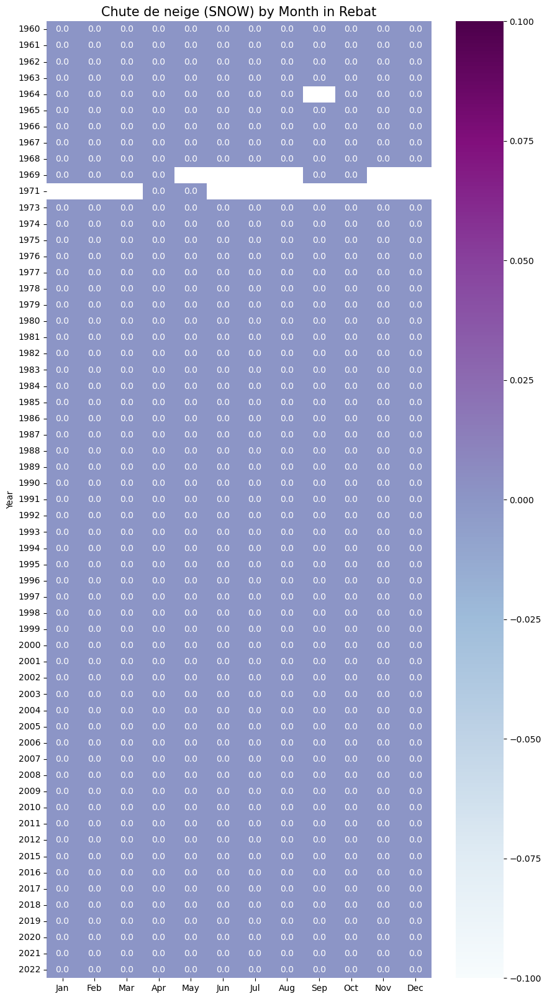

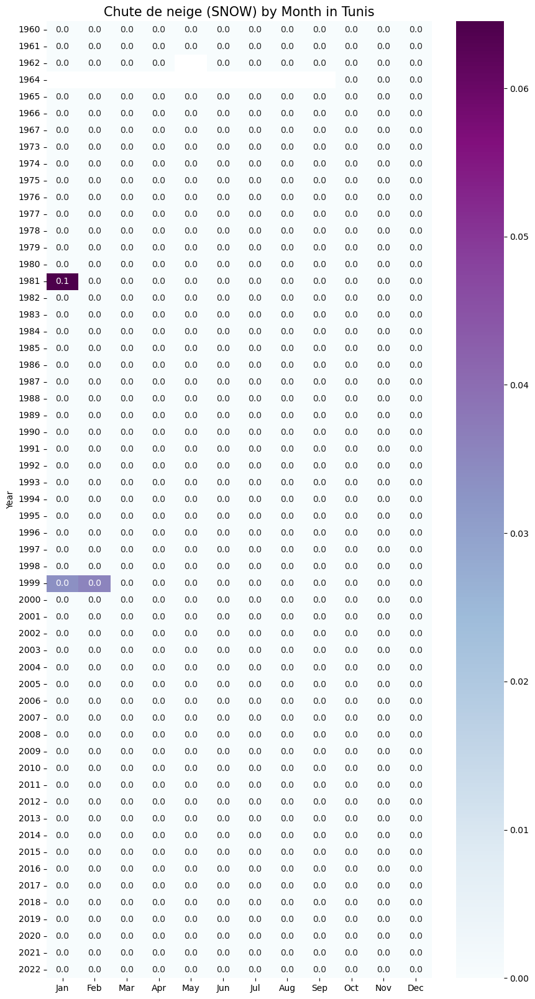

In [29]:
name=["Chute de neige (SNOW) by Month in Algiers",
      "Chute de neige (SNOW) by Month in Constantine",
      "Chute de neige (SNOW) by Month in Oran",
      "Chute de neige (SNOW) by Month in Rebat",
      "Chute de neige (SNOW) by Month in Tunis"]
months = ['Jan','Feb','Mar','Apr','May','Jun',
          'Jul','Aug','Sep','Oct','Nov','Dec']

for i in range(len(df)): 
    month_df= df[i].groupby(['Year','Month'], as_index=False)[['SNOW']].mean()
    data= month_df.pivot('Year','Month','SNOW')   
    data.columns = months
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='BuPu',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

# 3. La regression linéaire :

In [30]:
for i in range (len(df)):
    df[i] = df[i].set_index(['DATE']) 

création d'un Data Frame contenent les dates qu'on veut prédire, on commence par le "06.12.2022" .

In [31]:
pred =  pd.date_range(start="2022-12-06",end="2030-12-31")
pred = pred.to_frame()
pred['DATE'] = pred.index
pred =pred.reset_index(drop=True)
pred['Year']=pred['DATE'].dt.year 
pred['Month']=pred['DATE'].dt.month
pred['Day']=pred['DATE'].dt.day  

season_dict = {1: '1', 2: '1',
                 3: '2', 4: '2', 5: '3',
                 6: '3', 7: '3', 8: '3',
                 9: '4', 10: '4', 11: '4',
                 12: '1'}

pred['Season'] = pred['Month'].apply(lambda x: season_dict[x])
pred=pred.drop(pred.columns[0], axis=1)
pred= pred.set_index(['DATE'])
pred

,Year,Month,Day,Season
DATE,,,,
2022-12-06,2022,12,6,1
2022-12-07,2022,12,7,1
2022-12-08,2022,12,8,1
2022-12-09,2022,12,9,1
2022-12-10,2022,12,10,1
...,...,...,...,...
2030-12-27,2030,12,27,1
2030-12-28,2030,12,28,1
2030-12-29,2030,12,29,1


## overall implementation + évaluation + prédiction

In [32]:
df_pred = [0,1,2,3,4] #initialisation du dataframe qui contient les valeurs predites
name=["Alger","Constantine","Oran","Rabat","Tunis"]
print("L'évaluation des modéles pour toutes les villes : \n ")
for i in range (len(df)): 
    #features (Year, Month, Day, Season)
    X = df[i].drop(['TAVG','TMAX','TMIN','PRCP','SNOW'], axis=1) 
    #target (PRCP, TAVG, SNOW)
    Y = df[i].drop(['TMAX','TMIN','Year','Month','Day','Season'], axis=1) 
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)  
     
    #linear regression implementation 
    model = LinearRegression()
    model.fit(X_train, Y_train)
    
    #Evaluation du modél
    model_accuracy = model.score(X_test, Y_test)
    print("_____",name[i],"_____")
    print("model accuracy = ", model_accuracy)
    Y_pred=model.predict(X_test)
    MAE=mean_absolute_error(Y_test,Y_pred)
    MSE=mean_squared_error(Y_test,Y_pred)
    print('model mean absolute error MAE=',MAE)
    print('model mean squared error MSE=',MSE)
    print('model root mean squared error RMSE=',  np.sqrt(MSE))
    print("\n \n")
    
    #perdiction
    new_predicts=model.predict(pred)
    
    #préparation des donnés pour la visualisation
    new=pd.DataFrame(new_predicts)
    #renommé les colonnes
    new = new.rename(columns={new.columns[0]: 'PRCP' ,new.columns[1]: 'TAVG' ,new.columns[2]: 'SNOW'})
    #réinitialiser l'index
    new = new.set_index(pred.index)
    #concatenation du dataset des prédit avec l'original pour une visualisation global
    concat_data = pd.concat([pred,new],axis=1)
    concat_data=concat_data[['PRCP','TAVG','SNOW','Year','Month','Day','Season']]
    #suppression des colonnes inutiles
    df_ville =df[i].drop(['TMAX','TMIN'],axis=1)
    df_fin = pd.concat([df_ville,concat_data],axis=0)
    df_fin=df_fin.round(2)
    df_fin["SNOW"]=df_fin["SNOW"].abs()
    df_pred[i] = df_fin
    

L'évaluation des modéles pour toutes les villes : 
 
_____ Alger _____
model accuracy =  0.13813520023538106
model mean absolute error MAE= 2.1069097859915824
model mean squared error MSE= 18.770559224384908
model root mean squared error RMSE= 4.3325003432642575

 

_____ Constantine _____
model accuracy =  0.1286129986890743
model mean absolute error MAE= 2.2115166822150223
model mean squared error MSE= 21.678411132031144
model root mean squared error RMSE= 4.656008068295323

 

_____ Oran _____
model accuracy =  0.13336504985850964
model mean absolute error MAE= 1.5026594390871821
model mean squared error MSE= 8.83929829625569
model root mean squared error RMSE= 2.9730957428673044

 

_____ Rabat _____
model accuracy =  0.4669002399705162
model mean absolute error MAE= 1.6067174632660546
model mean squared error MSE= 12.250668817526218
model root mean squared error RMSE= 3.500095544056793

 

_____ Tunis _____
model accuracy =  0.13412388491568902
model mean absolute error MAE= 1.871

le résultats des Data Frame Predits:

#### Alger : ( 1960 - 2030 )

In [33]:
print(df_pred[0])

            PRCP   TAVG  SNOW  Year  Month  Day Season
DATE                                                  
1960-01-01  0.00  11.00   0.0  1960      1    1      1
1960-01-02  0.00  11.00   0.0  1960      1    2      1
1960-01-03  0.00  12.40   0.0  1960      1    3      1
1960-01-04  0.00  10.70   0.0  1960      1    4      1
1960-01-05  0.00  11.80   0.0  1960      1    5      1
...          ...    ...   ...   ...    ...  ...    ...
2030-12-27  4.16  13.95   0.0  2030     12   27      1
2030-12-28  4.16  13.96   0.0  2030     12   28      1
2030-12-29  4.17  13.96   0.0  2030     12   29      1
2030-12-30  4.17  13.97   0.0  2030     12   30      1
2030-12-31  4.17  13.98   0.0  2030     12   31      1

[25928 rows x 7 columns]


In [34]:
print(df_pred[0].isnull().sum())

PRCP      0
TAVG      0
SNOW      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


#### Constantine :  ( 1960 - 2030 )

In [35]:
print(df_pred[1])

            PRCP   TAVG  SNOW  Year  Month  Day Season
DATE                                                  
1961-03-01  1.89   8.20  0.00  1961      3    1      2
1961-03-16  1.89  10.60  0.00  1961      3   16      2
1961-03-25  1.89   8.60  0.00  1961      3   25      2
1961-12-16  2.48   8.30  0.00  1961     12   16      1
1961-12-20  2.48   2.50  1.00  1961     12   20      1
...          ...    ...   ...   ...    ...  ...    ...
2030-12-27  2.35   9.10  0.03  2030     12   27      1
2030-12-28  2.35   9.11  0.03  2030     12   28      1
2030-12-29  2.35   9.12  0.03  2030     12   29      1
2030-12-30  2.35   9.13  0.03  2030     12   30      1
2030-12-31  2.35   9.14  0.03  2030     12   31      1

[22014 rows x 7 columns]


In [36]:
print(df_pred[1].isnull().sum())

PRCP      0
TAVG      0
SNOW      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


#### Oran :  ( 1960 - 2030 )

In [37]:
print(df_pred[2])

            PRCP   TAVG  SNOW  Year  Month  Day Season
DATE                                                  
1960-01-01  1.47   8.90   0.0  1960      1    1      1
1960-01-02  1.47   9.40   0.0  1960      1    2      1
1960-01-03  1.47  12.20   0.0  1960      1    3      1
1960-01-04  1.47  11.40   0.0  1960      1    4      1
1960-01-05  1.47  12.10   0.0  1960      1    5      1
...          ...    ...   ...   ...    ...  ...    ...
2030-12-27  1.34  13.79   0.0  2030     12   27      1
2030-12-28  1.35  13.80   0.0  2030     12   28      1
2030-12-29  1.36  13.81   0.0  2030     12   29      1
2030-12-30  1.37  13.81   0.0  2030     12   30      1
2030-12-31  1.38  13.82   0.0  2030     12   31      1

[22837 rows x 7 columns]


In [38]:
print(df_pred[2].isnull().sum())

PRCP      0
TAVG      0
SNOW      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


#### Rabat :  ( 1960 - 2030 )

In [39]:
print(df_pred[3])

            PRCP   TAVG  SNOW  Year  Month  Day Season
DATE                                                  
1960-01-01  0.50  12.50   0.0  1960      1    1      1
1960-01-02  1.59  13.60   0.0  1960      1    2      1
1960-01-03  0.00  12.50   0.0  1960      1    3      1
1960-01-04  0.00  11.40   0.0  1960      1    4      1
1960-01-05  0.00  12.80   0.0  1960      1    5      1
...          ...    ...   ...   ...    ...  ...    ...
2030-12-27  4.16  13.39   0.0  2030     12   27      1
2030-12-28  4.15  13.39   0.0  2030     12   28      1
2030-12-29  4.14  13.40   0.0  2030     12   29      1
2030-12-30  4.13  13.40   0.0  2030     12   30      1
2030-12-31  4.13  13.41   0.0  2030     12   31      1

[23864 rows x 7 columns]


In [40]:
print(df_pred[3].isnull().sum())

PRCP      0
TAVG      0
SNOW      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


#### Tunis :  ( 1960 - 2030 )

In [41]:
print(df_pred[4])

            PRCP   TAVG  SNOW  Year  Month  Day Season
DATE                                                  
1960-01-01  2.16  12.90   0.0  1960      1    1      1
1960-01-02  2.16  12.50   0.0  1960      1    2      1
1960-01-03  2.16  13.80   0.0  1960      1    3      1
1960-01-04  2.16  13.50   0.0  1960      1    4      1
1960-01-06  2.16  10.70   0.0  1960      1    6      1
...          ...    ...   ...   ...    ...  ...    ...
2030-12-27  2.03  14.33   0.0  2030     12   27      1
2030-12-28  2.03  14.33   0.0  2030     12   28      1
2030-12-29  2.03  14.34   0.0  2030     12   29      1
2030-12-30  2.04  14.34   0.0  2030     12   30      1
2030-12-31  2.04  14.35   0.0  2030     12   31      1

[22675 rows x 7 columns]


In [42]:
print(df_pred[4].isnull().sum())

PRCP      0
TAVG      0
SNOW      0
Year      0
Month     0
Day       0
Season    0
dtype: int64


#### on peut faire des implémentation de chaque target pour chaque ville séparement comme suivant:

In [43]:
name=["Algiers","Constantine","Oran","Rebat","Tunis"]
models=[0,1,2,3,4]
for i in range(len(df)):
    def predict_data(target):
        Y=df[i][target]
        X=df[i].drop(target, axis=1)
        X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
        model = LinearRegression()
        models[i]=model.fit(X_train, Y_train)
        accuracy=models[i].score(X_test,Y_test)
        return accuracy
    
    accuracy =predict_data(target='TAVG')
    print('model accuracy that predict the TAVG in',name[i],'is :',accuracy) 
    accuracy =predict_data(target='PRCP')
    print('model accuracy that predict the PRCP in',name[i],'is :',accuracy) 
    accuracy =predict_data(target='SNOW')
    print('model accuracy that predict the SNOW in',name[i],'is :',accuracy) 
    print('\n')
    

model accuracy that predict the TAVG in Algiers is : 0.9858629667998887
model accuracy that predict the PRCP in Algiers is : 0.1197496217523153
model accuracy that predict the SNOW in Algiers is : 0.008124951514632994


model accuracy that predict the TAVG in Constantine is : 0.99301693522478
model accuracy that predict the PRCP in Constantine is : 0.04526898841222726
model accuracy that predict the SNOW in Constantine is : 0.06988810053319372


model accuracy that predict the TAVG in Oran is : 0.9865587688523372
model accuracy that predict the PRCP in Oran is : 0.05633526874826267
model accuracy that predict the SNOW in Oran is : 0.0026455704243246725


model accuracy that predict the TAVG in Rebat is : 0.9845801428340116
model accuracy that predict the PRCP in Rebat is : 0.08188189477446228
model accuracy that predict the SNOW in Rebat is : 1.0


model accuracy that predict the TAVG in Tunis is : 0.989844947190625
model accuracy that predict the PRCP in Tunis is : 0.02198816947773607

# 4. updated visualization '1960-2030'

## 4.1 Par années :

### Température moyenne 'TAVG'

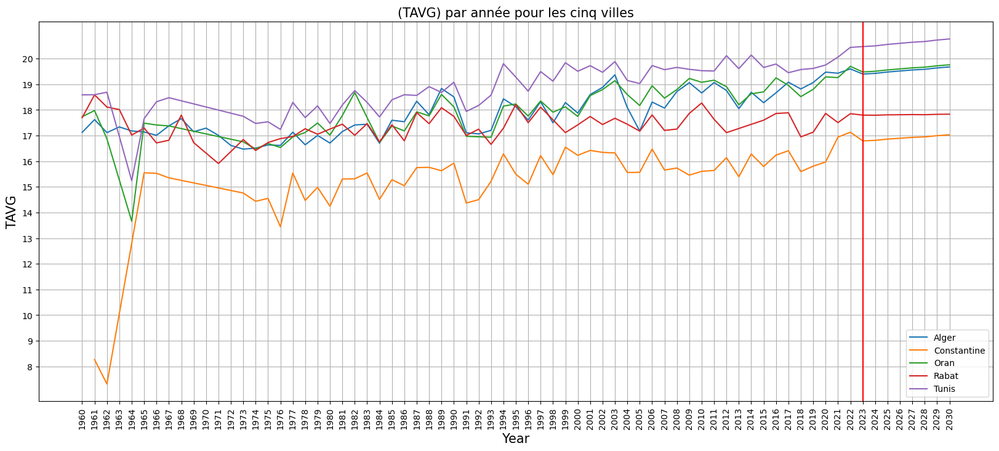

In [44]:
fig, ax = plt.subplots(figsize=(20,8))
df_pred[0].groupby(df_pred[0]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()
df_pred[1].groupby(df_pred[1]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()
df_pred[2].groupby(df_pred[2]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()
df_pred[3].groupby(df_pred[3]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()
df_pred[4].groupby(df_pred[4]["Year"]).apply(lambda x: x["TAVG"].mean()).plot()

plt.xlabel("Year",fontsize=15)
plt.ylabel("TAVG",fontsize=15)
plt.title("(TAVG) par année pour les cinq villes",fontsize=15)
plt.legend(["Alger","Constantine","Oran","Rabat","Tunis"]) 
plt.xticks(np.arange(1960, 2031 , 1),rotation=90)
plt.yticks(np.arange(8, 21 , 1))
plt.axvline(x = 2023, color = 'red', label = 'axvline - full height')
plt.grid()
plt.show()

### Précipitation 'PRCP' :

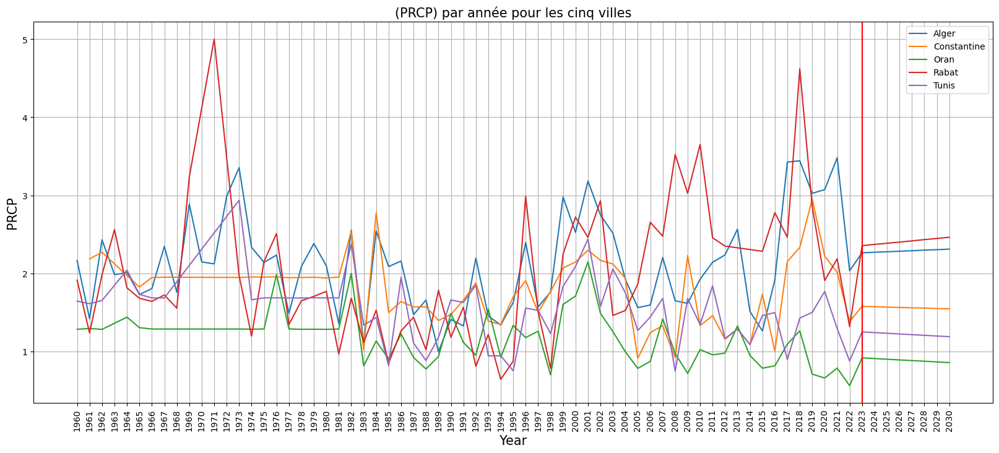

In [45]:
fig, ax = plt.subplots(figsize=(20,8))
df_pred[0].groupby(df_pred[0]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()
df_pred[1].groupby(df_pred[1]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()
df_pred[2].groupby(df_pred[2]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()
df_pred[3].groupby(df_pred[3]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()
df_pred[4].groupby(df_pred[4]["Year"]).apply(lambda x: x["PRCP"].mean()).plot()

plt.xlabel("Year",fontsize=15)
plt.ylabel("PRCP",fontsize=15)
plt.title("(PRCP) par année pour les cinq villes",fontsize=15)
plt.legend(["Alger","Constantine","Oran","Rabat","Tunis"]) 
plt.xticks(np.arange(1960, 2031 , 1),rotation=90)
plt.axvline(x = 2023, color = 'red', label = 'axvline - full height')
plt.grid()
plt.show()

### Chute de neige 'SNOW'

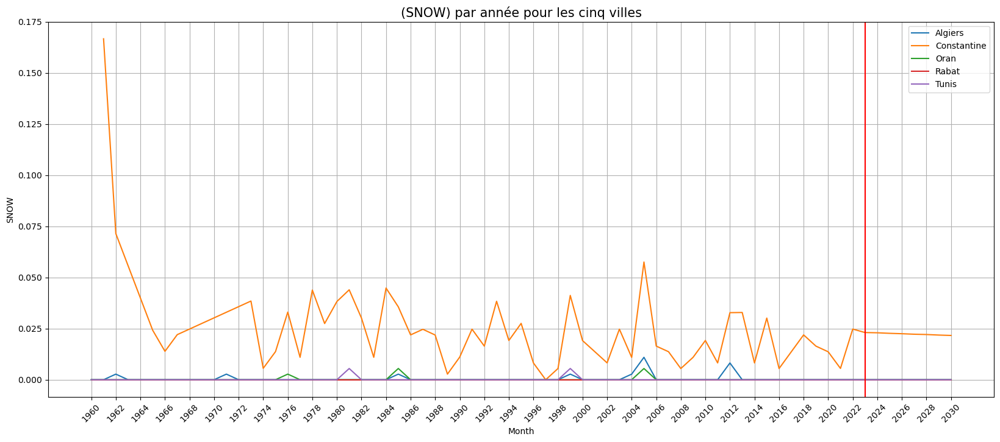

In [46]:
fig, ax = plt.subplots(figsize=(20,8))
df_pred[0].groupby(df_pred[0]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()
df_pred[1].groupby(df_pred[1]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()
df_pred[2].groupby(df_pred[2]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()
df_pred[3].groupby(df_pred[3]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()
df_pred[4].groupby(df_pred[4]["Year"]).apply(lambda x: x["SNOW"].mean()).plot()

plt.xlabel("Month",fontsize=10)
plt.ylabel("SNOW",fontsize=10)
plt.title("(SNOW) par année pour les cinq villes",fontsize=15)
plt.legend(["Algiers","Constantine","Oran","Rabat","Tunis"]) 
plt.xticks(np.arange(1960, 2031 , 2),rotation=45)
plt.axvline(x = 2023, color = 'red', label = 'axvline - full height')
plt.grid()
plt.grid(True) 
plt.show()

## 4.2 Par saisons:

### Température moyenne 'TAVG'

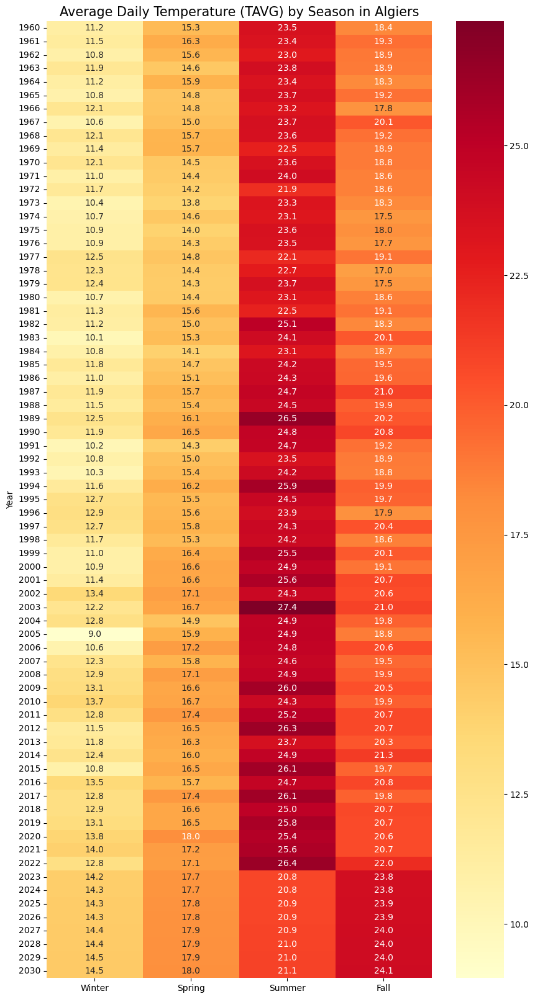

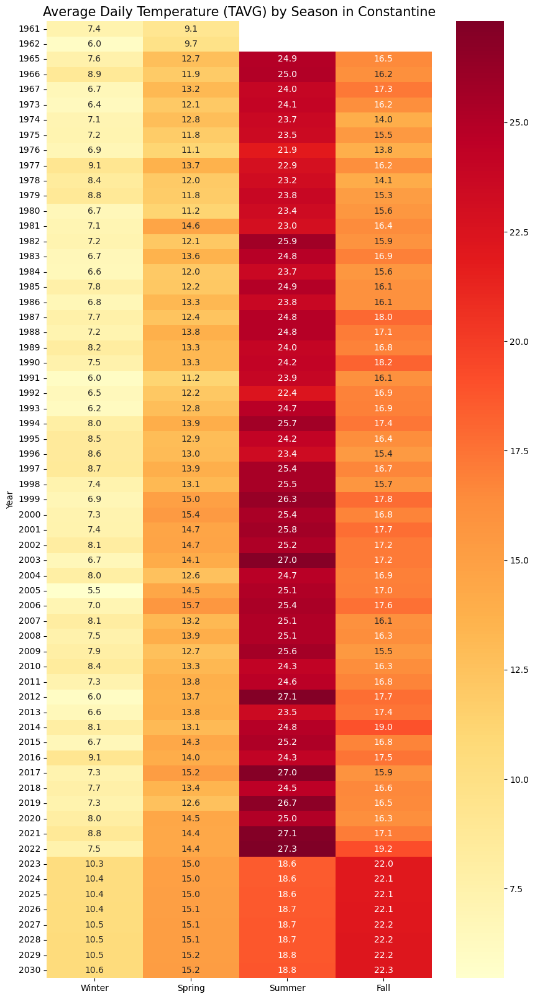

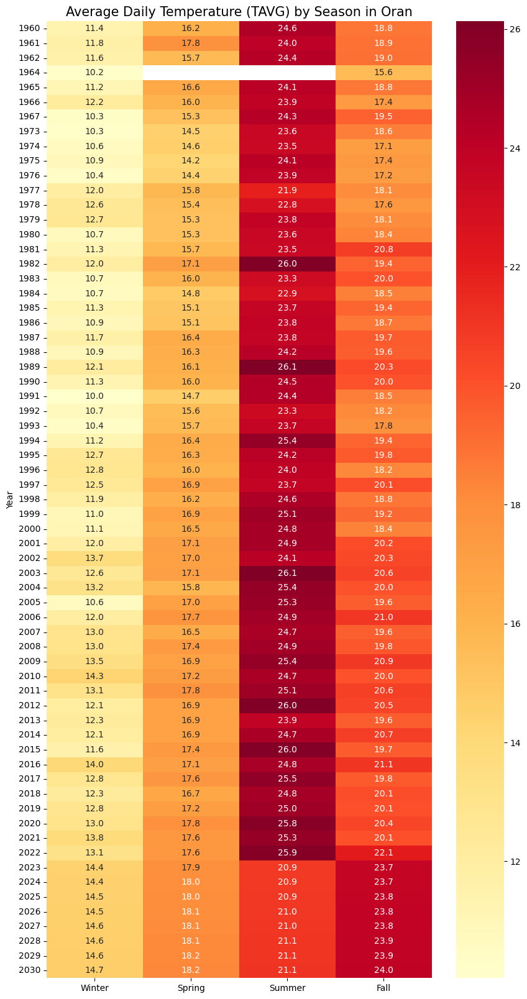

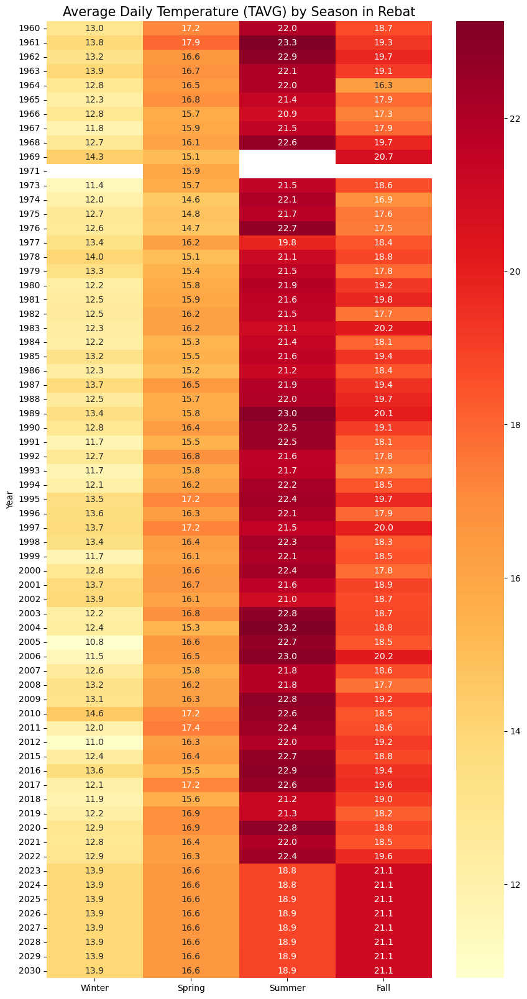

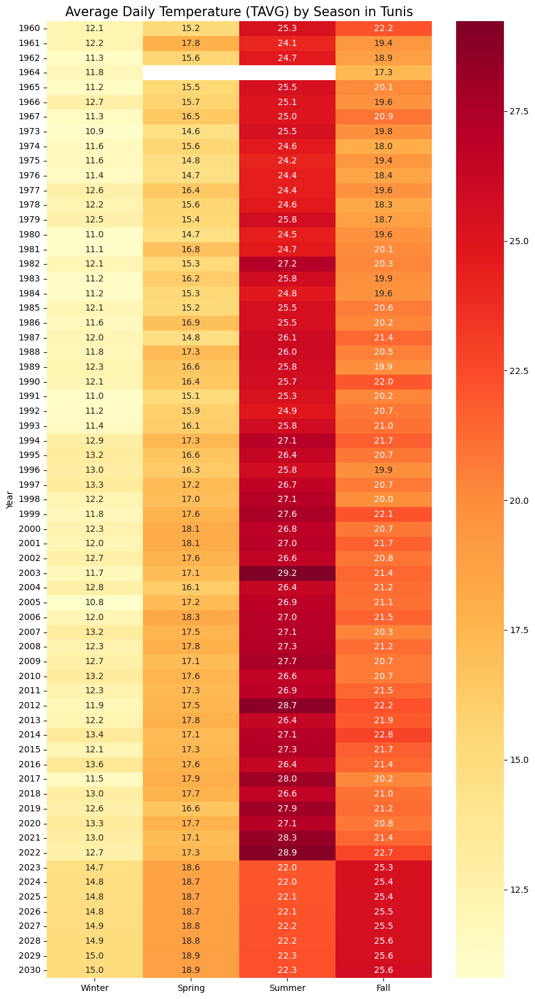

In [47]:
name=["Average Daily Temperature (TAVG) by Season in Algiers",
      "Average Daily Temperature (TAVG) by Season in Constantine",
      "Average Daily Temperature (TAVG) by Season in Oran",
      "Average Daily Temperature (TAVG) by Season in Rebat",
      "Average Daily Temperature (TAVG) by Season in Tunis"]
seasons = ['Winter','Spring','Summer','Fall'] 

for i in range(len(df_pred)): 
    season_df= df_pred[i].groupby(['Year','Season'], as_index=False)[['TAVG']].mean()
    data= season_df.pivot('Year','Season','TAVG')   
    data.columns = seasons
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='YlOrRd',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

### Précipitation 'PRCP'

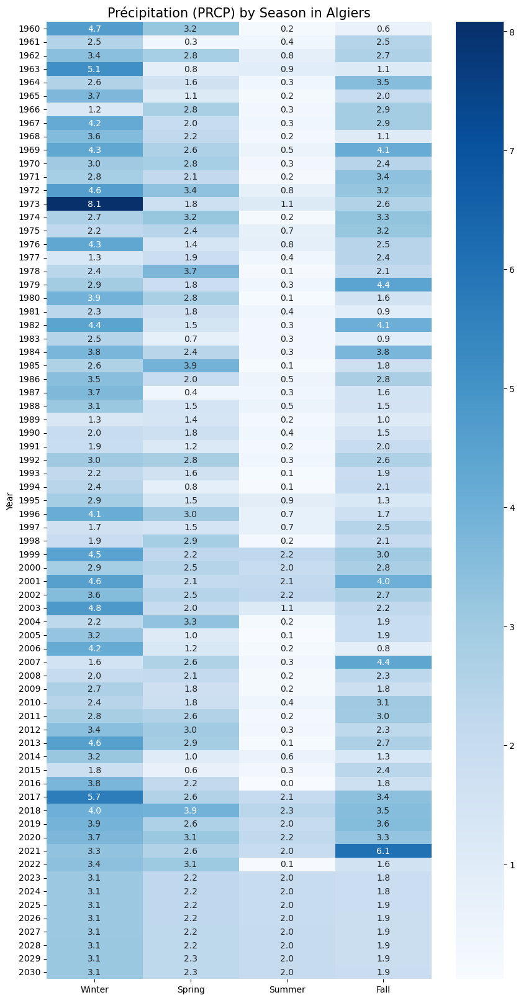

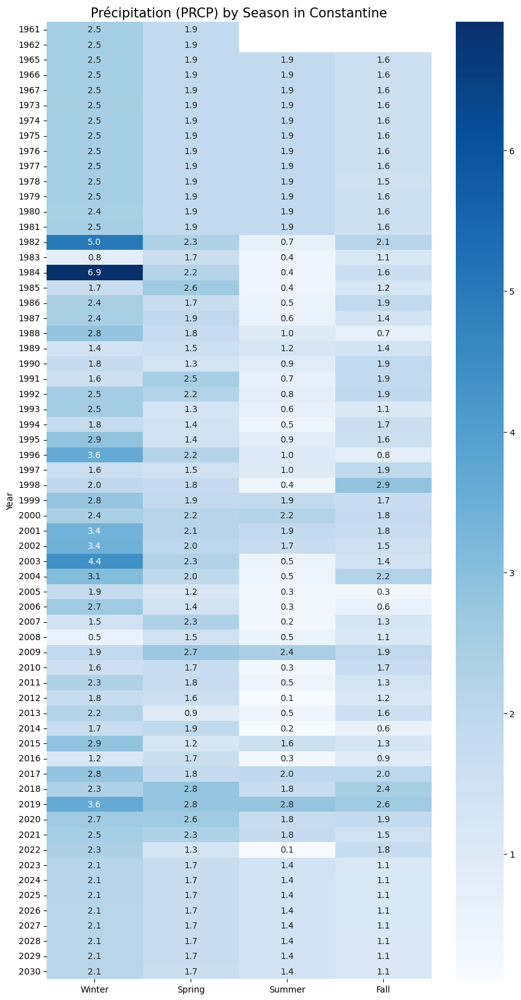

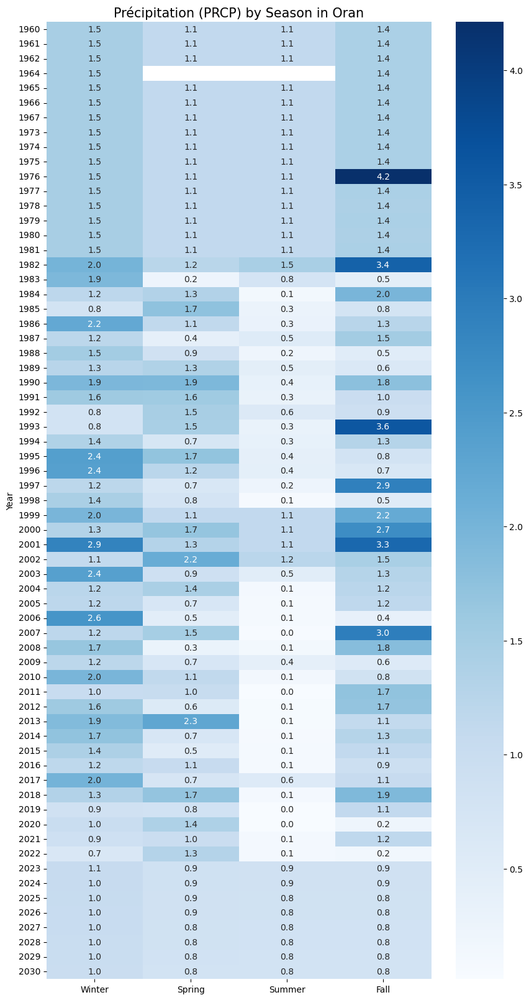

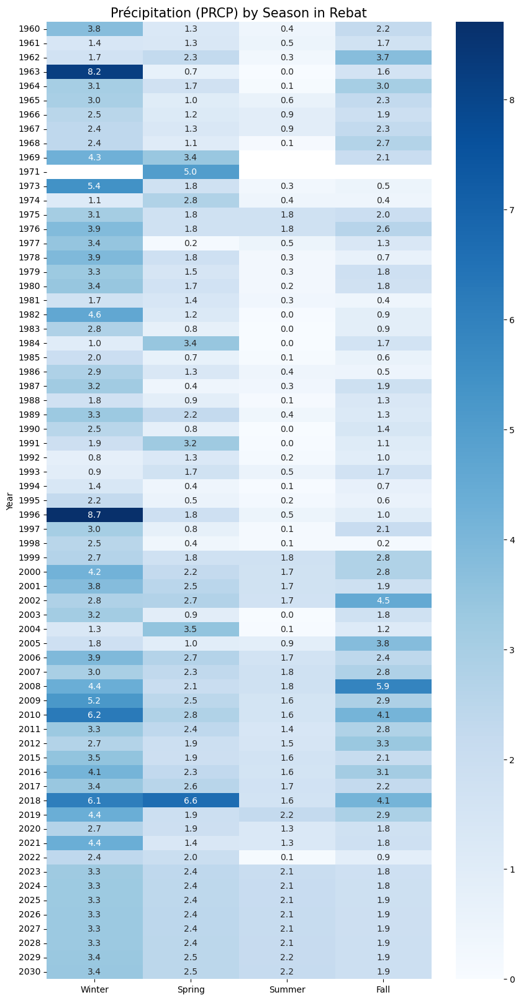

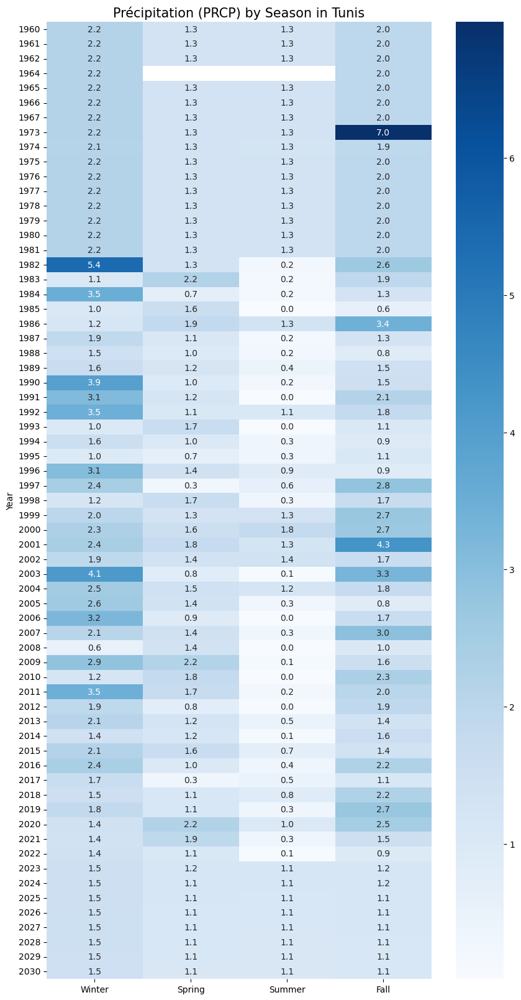

In [48]:
name=["Précipitation (PRCP) by Season in Algiers",
      "Précipitation (PRCP) by Season in Constantine",
      "Précipitation (PRCP) by Season in Oran",
      "Précipitation (PRCP) by Season in Rebat",
      "Précipitation (PRCP) by Season in Tunis"]
seasons = ['Winter','Spring','Summer','Fall'] 

for i in range(len(df_pred)): 
    season_df= df_pred[i].groupby(['Year','Season'], as_index=False)[['PRCP']].mean()
    data= season_df.pivot('Year','Season','PRCP')   
    data.columns = seasons
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='Blues',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

### chute de neige 'SNOW'

2- par la moyen de chaque saison dans toutes les années et chaque ville séparément

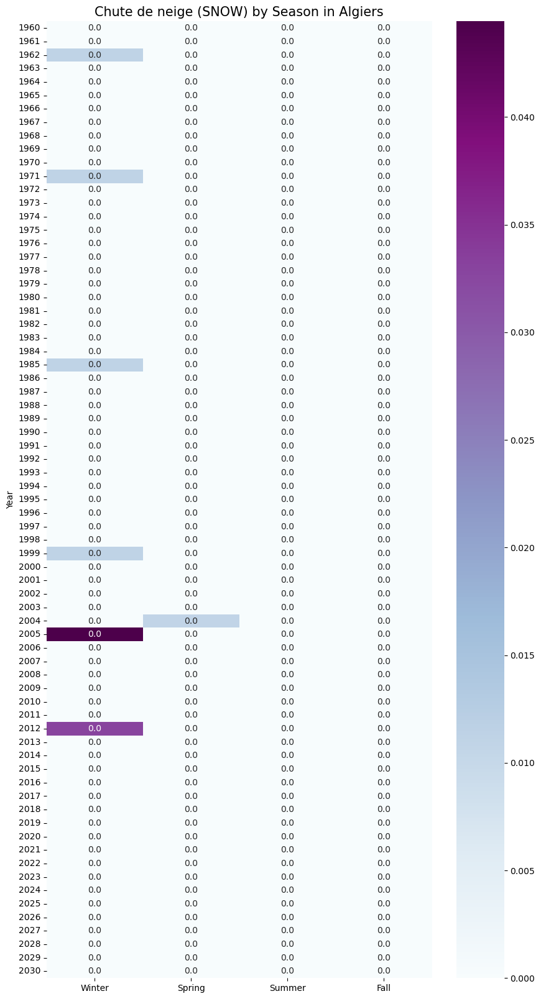

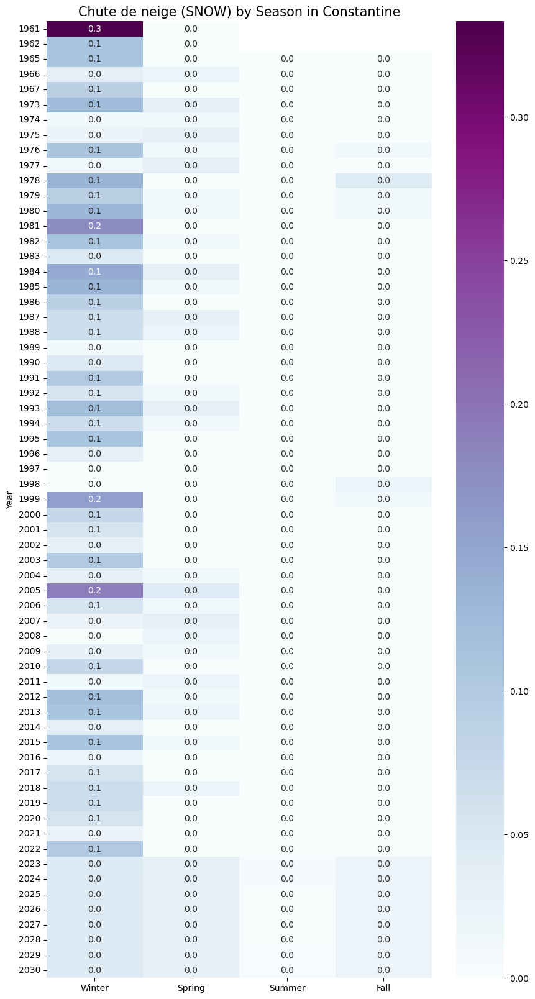

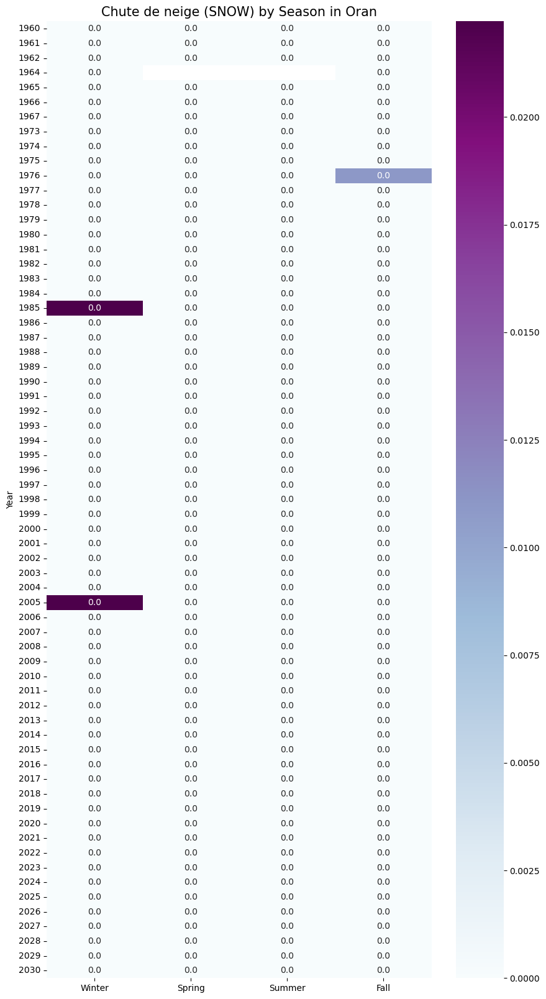

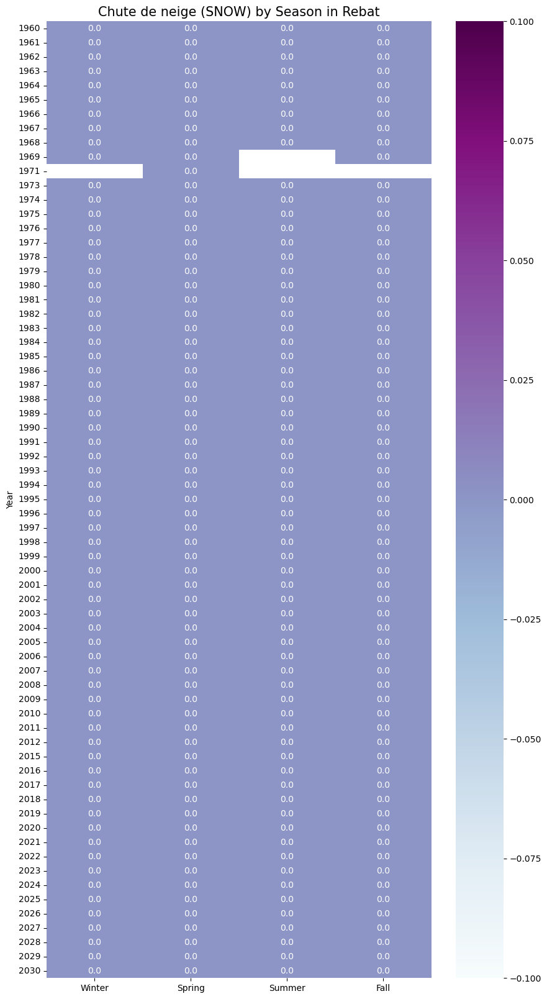

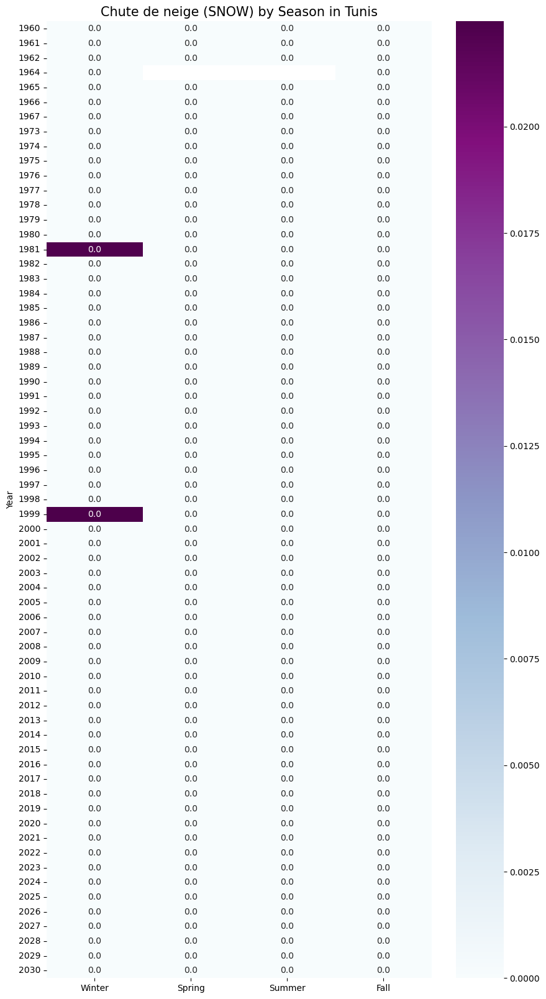

In [49]:
name=["Chute de neige (SNOW) by Season in Algiers",
      "Chute de neige (SNOW) by Season in Constantine",
      "Chute de neige (SNOW) by Season in Oran",
      "Chute de neige (SNOW) by Season in Rebat",
      "Chute de neige (SNOW) by Season in Tunis"]
seasons = ['Winter','Spring','Summer','Fall'] 

for i in range(len(df_pred)): 
    season_df= df_pred[i].groupby(['Year','Season'], as_index=False)[['SNOW']].mean()
    data= season_df.pivot('Year','Season','SNOW')   
    data.columns = seasons
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='BuPu',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

# 4.3 Par mois : 

### Température moyenne 'TAVG' :

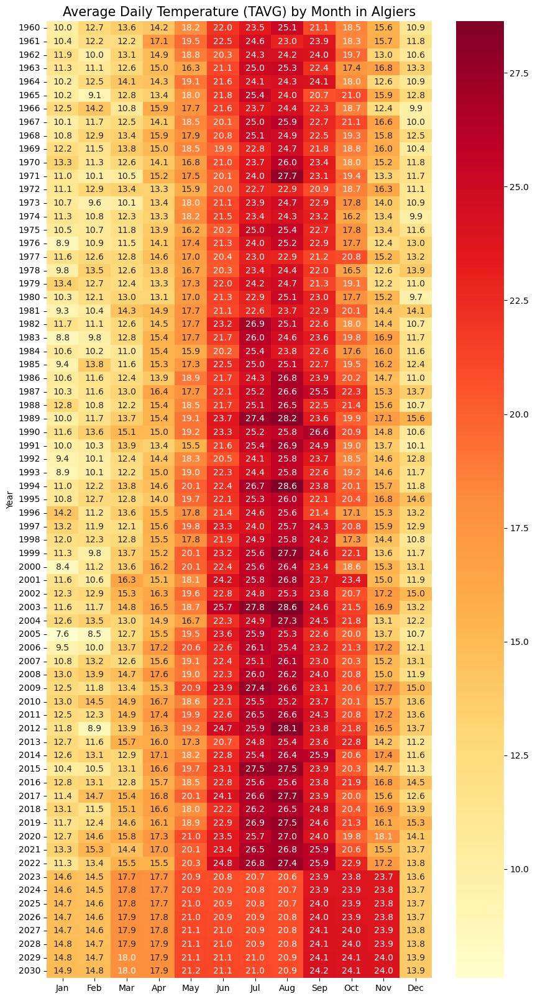

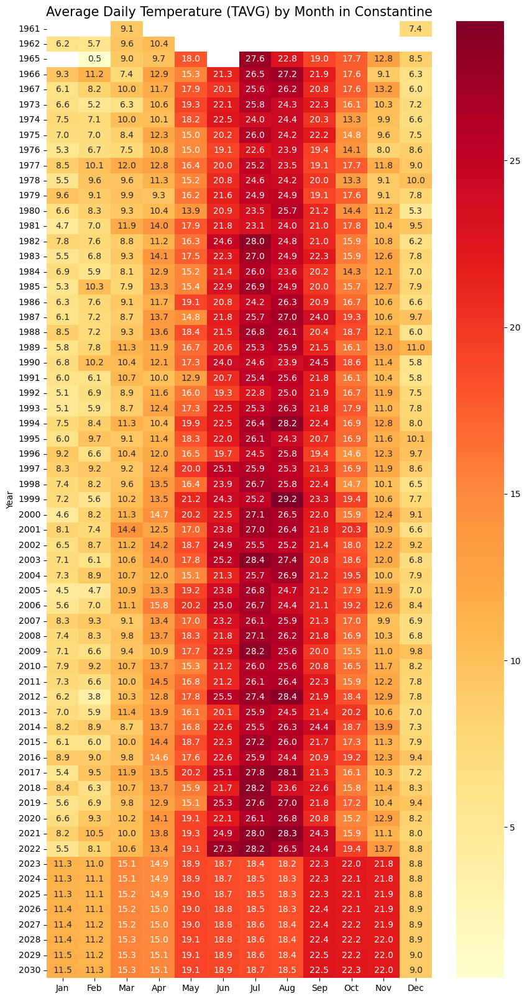

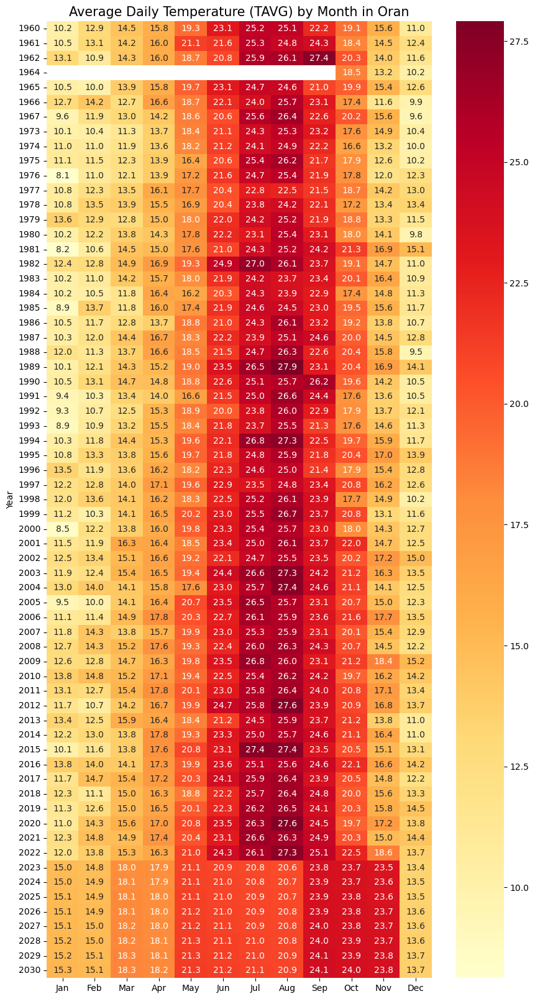

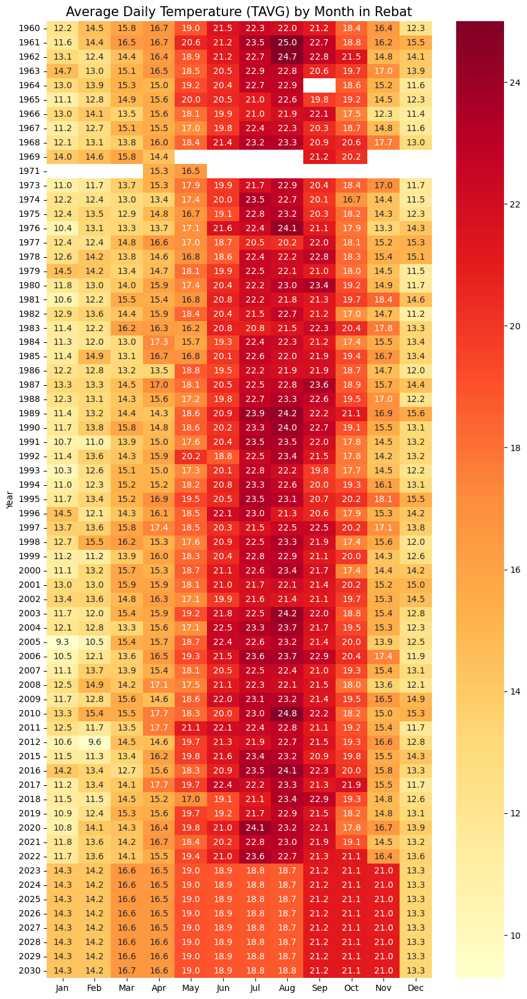

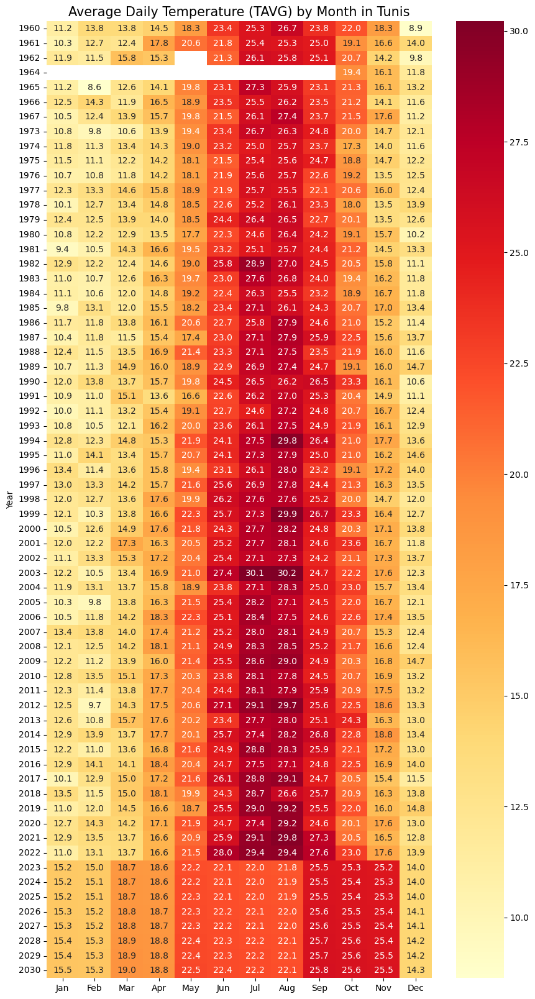

In [50]:
name=["Average Daily Temperature (TAVG) by Month in Algiers",
      "Average Daily Temperature (TAVG) by Month in Constantine",
      "Average Daily Temperature (TAVG) by Month in Oran",
      "Average Daily Temperature (TAVG) by Month in Rebat",
      "Average Daily Temperature (TAVG) by Month in Tunis"]
months = ['Jan','Feb','Mar','Apr','May','Jun',
          'Jul','Aug','Sep','Oct','Nov','Dec']

for i in range(len(df_pred)): 
    month_df= df_pred[i].groupby(['Year','Month'], as_index=False)[['TAVG']].mean()
    data= month_df.pivot('Year','Month','TAVG')   
    data.columns = months
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='YlOrRd',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

### Précipitation 'PRCP'

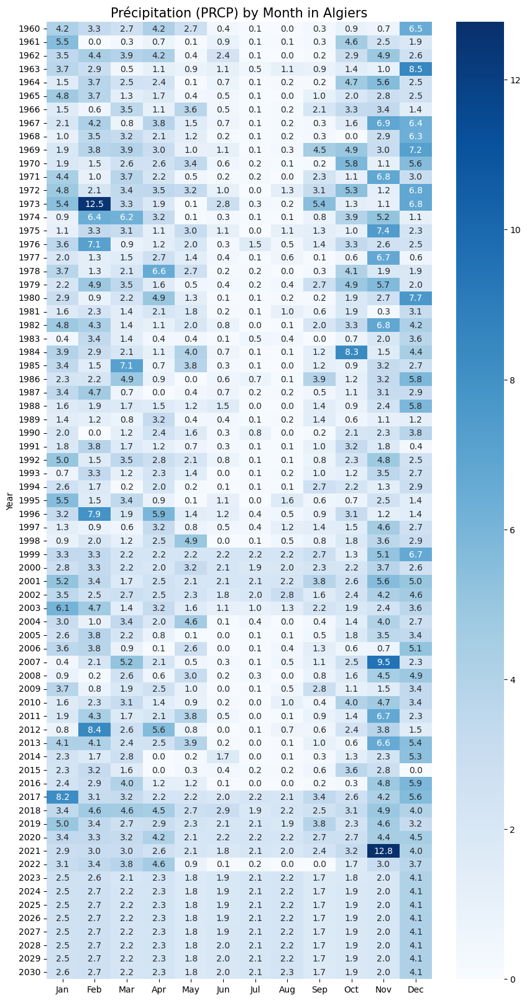

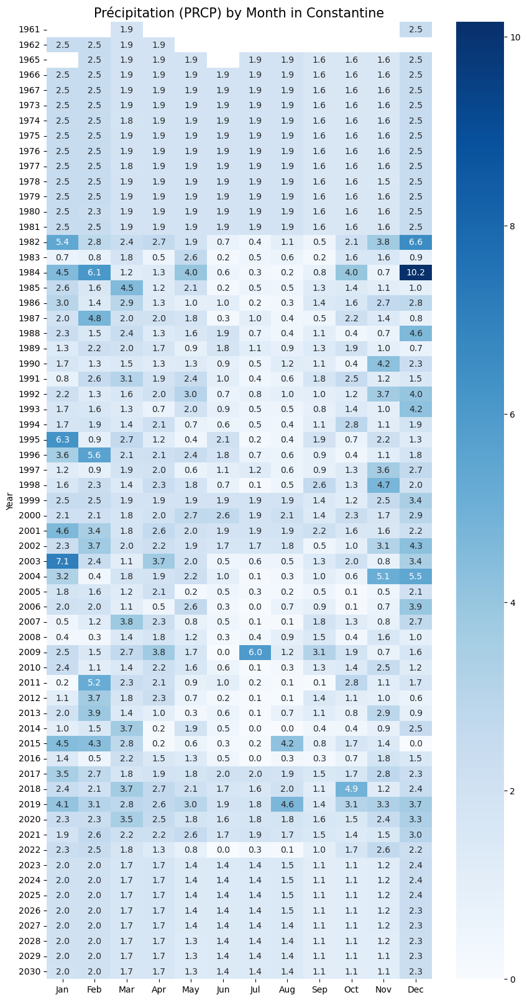

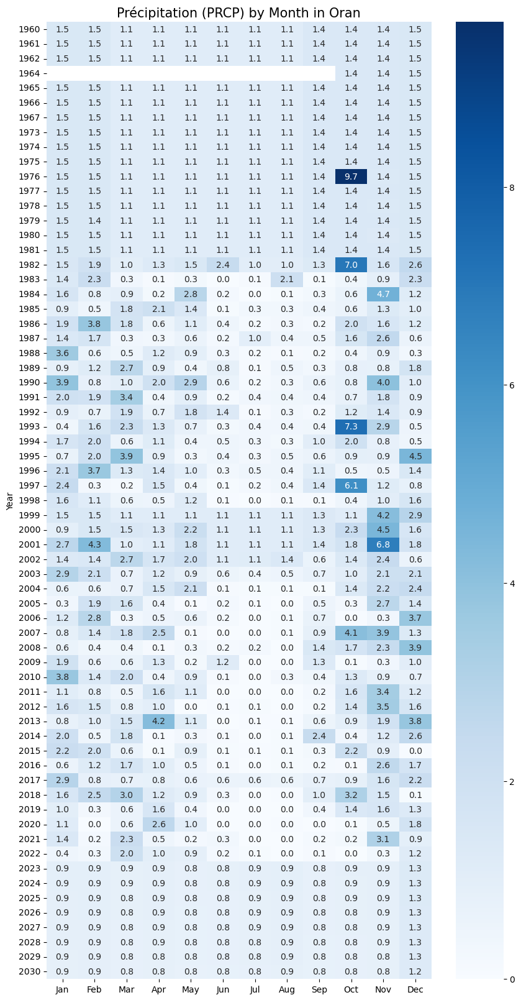

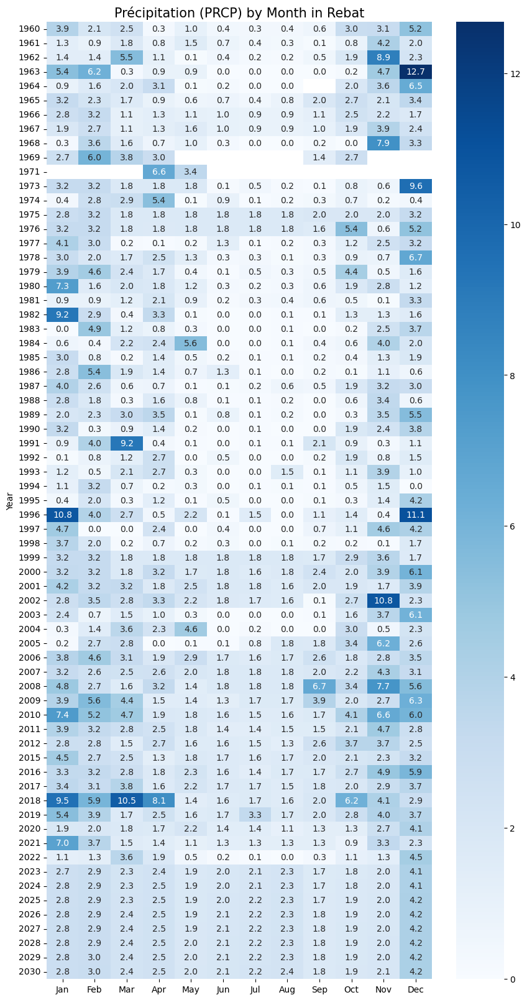

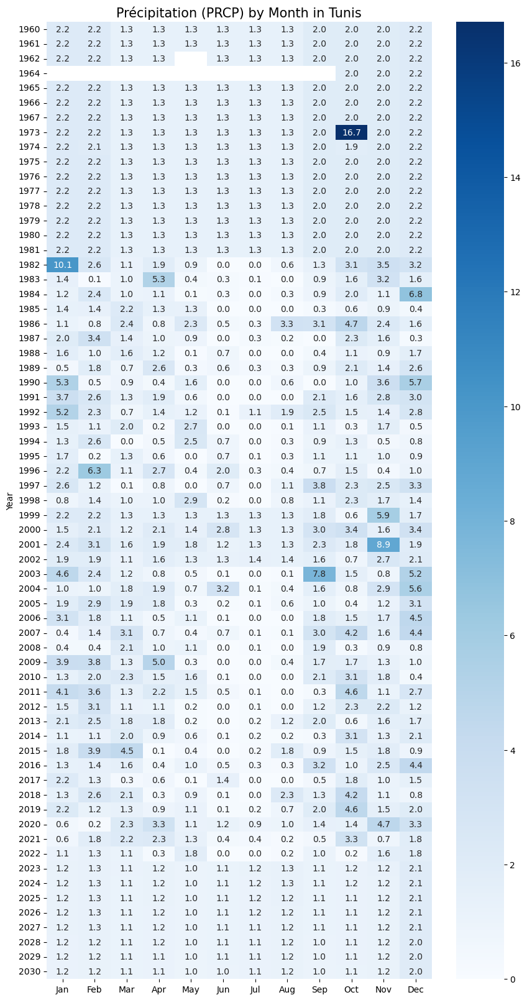

In [51]:
name=["Précipitation (PRCP) by Month in Algiers",
      "Précipitation (PRCP) by Month in Constantine",
      "Précipitation (PRCP) by Month in Oran",
      "Précipitation (PRCP) by Month in Rebat",
      "Précipitation (PRCP) by Month in Tunis"]
months = ['Jan','Feb','Mar','Apr','May','Jun',
          'Jul','Aug','Sep','Oct','Nov','Dec']

for i in range(len(df_pred)): 
    month_df= df_pred[i].groupby(['Year','Month'], as_index=False)[['PRCP']].mean()
    data= month_df.pivot('Year','Month','PRCP')   
    data.columns = months
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='Blues',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

### Chute de neige 'SNOW'

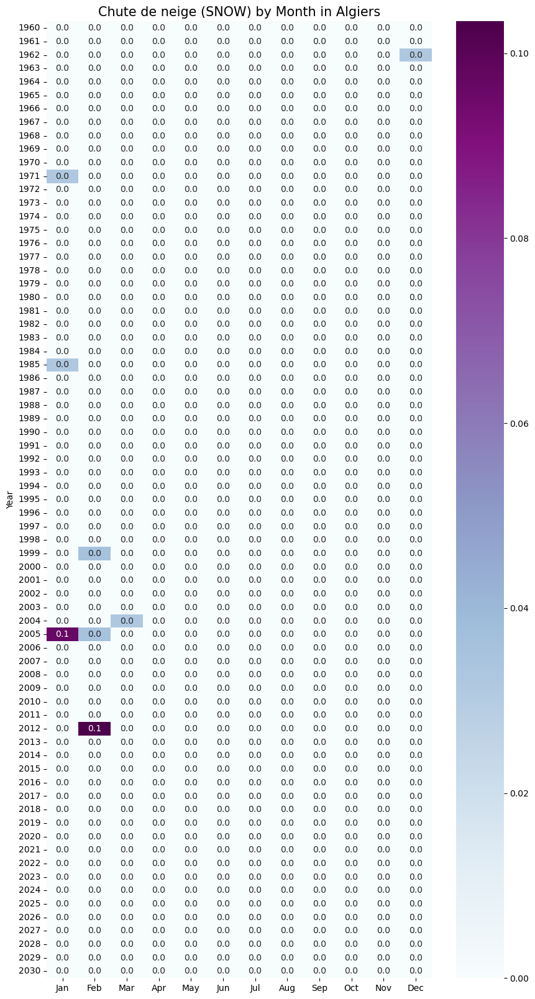

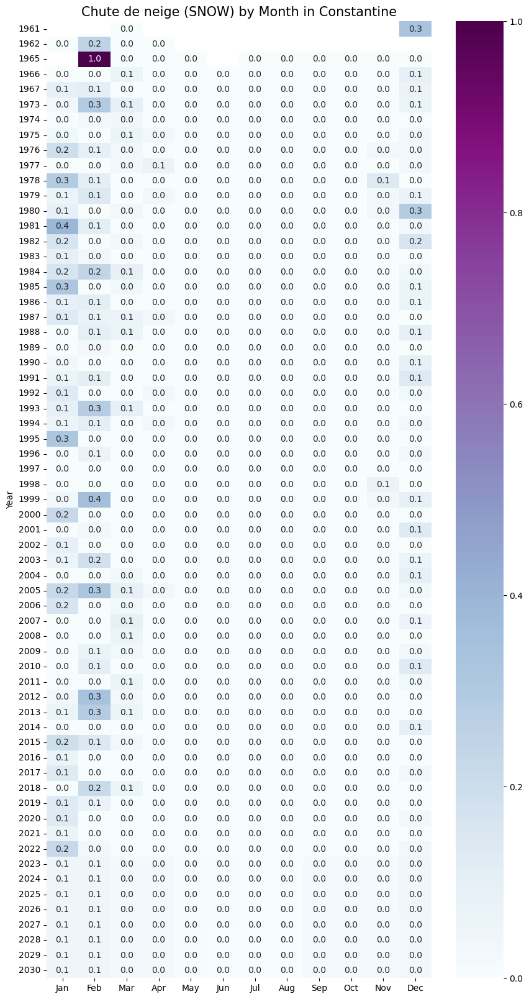

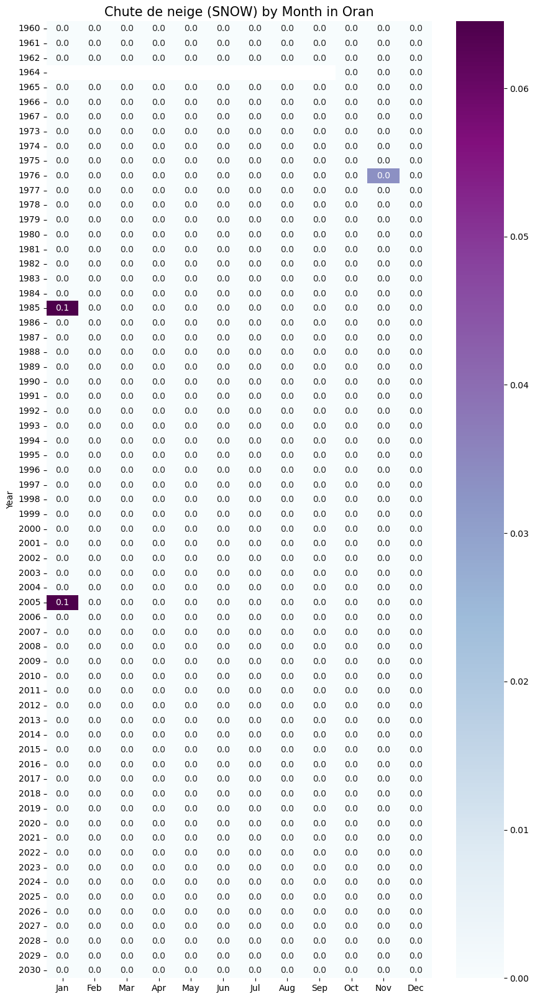

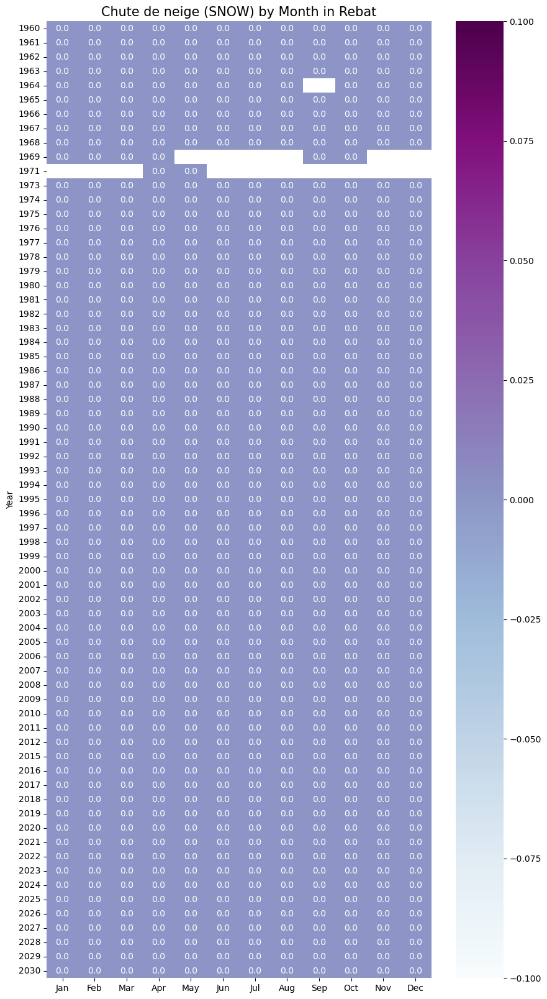

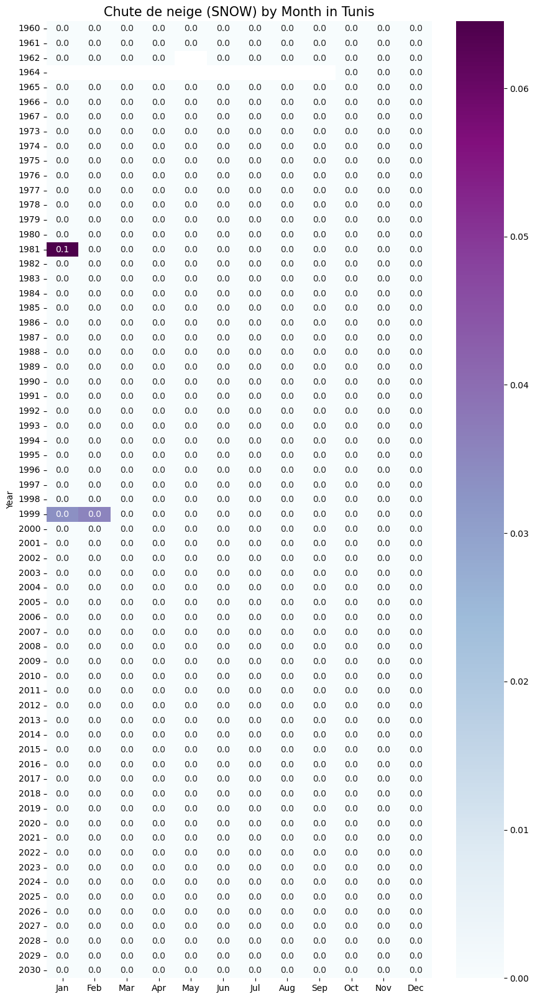

In [52]:
name=["Chute de neige (SNOW) by Month in Algiers",
      "Chute de neige (SNOW) by Month in Constantine",
      "Chute de neige (SNOW) by Month in Oran",
      "Chute de neige (SNOW) by Month in Rebat",
      "Chute de neige (SNOW) by Month in Tunis"]
months = ['Jan','Feb','Mar','Apr','May','Jun',
          'Jul','Aug','Sep','Oct','Nov','Dec']

for i in range(len(df_pred)): 
    month_df= df_pred[i].groupby(['Year','Month'], as_index=False)[['SNOW']].mean()
    data= month_df.pivot('Year','Month','SNOW')   
    data.columns = months
    plt.subplots(figsize=(10,20))
    sns.heatmap(data, cmap='BuPu',annot=True,fmt='.1f') 
    plt.title(name[i],fontsize=15)
    plt.yticks(rotation=0)
    plt.show()

## le temps d'executions 

In [53]:
end = datetime.now()
print("l'executions de toutes les cellules a pris : ",end - start)

l'executions de toutes les cellules a pris :  0:05:14.609944
